<h1><center>Final Year Project</center></h1>
<h2><center> Astronomical DataScience: Galaxy Analysis and Detection of Blackhole</center></h2>

### About the Galaxy
- **NGC 6946** is an intermediate spiral firework galaxy with small bright nucleus whose loction straddles the boundry between the northen constellations of Cepheus and Cygnus which is 25.2 million light years away from Earth
- Its about one-third of the Milky Way's size it contains roughly half the number of stars as the Milky Way. It is heavily obscured by interstellar matter due to its location close to the galactic plane of the Milky Way. Due to its prodigious star formation it has been classified as an active starburst galaxy.
- This includes the so-called 'Red Ellipse' along one of the northern arms that looks like a super-bubble or very large supernova remnant, and which may have been formed by an open cluster containing massive stars. There are also two regions of unusual dark lanes of nebulosity, while within the spiral arms several regions appear devoid of stars and gaseous hydrogen

In [1]:
#Importing Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as npl
import matplotlib.cm as mtpltcm
from mpl_toolkits.mplot3d import Axes3D
import random
import time

import warnings
warnings.filterwarnings('ignore')

In [2]:
#PATH PROCESS
import os
import os.path
from pathlib import Path
import glob
from scipy.io import loadmat
import nibabel as nib
import csv

In [3]:
#Importing Astronmical Libraries
from astropy.visualization import astropy_mpl_style
from astropy.utils.data import get_pkg_data_filename
from astropy.io import fits
import astropy
from astropy import units as u 
import astropy.wcs as fitswcs
from astropy.cosmology import WMAP9 as Cosmology

In [4]:
#Importing Image Processing Libraries

from PIL import Image
from keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from keras.applications.vgg16 import preprocess_input, decode_predictions
from keras.preprocessing import image
from skimage.feature import hessian_matrix, hessian_matrix_eigvals
from scipy.ndimage.filters import convolve
from skimage import data, io, filters
import skimage.morphology as morph
import skimage.exposure as skie
import skimage
from skimage.morphology import convex_hull_image, erosion
from IPython import display
from scipy.ndimage import gaussian_filter
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.patches as patches

In [5]:
#Importing scaler and transformation libraries
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from keras.utils.np_utils import to_categorical
from sklearn.model_selection import train_test_split
from keras import regularizers
from sklearn.preprocessing import LabelEncoder
import sklearn

In [6]:
#Importing few more libraries
from scipy.io.wavfile import read, write
import librosa
import librosa.display
import IPython
from IPython.display import Audio
import scipy
from scipy import signal
from scipy.fft import fftshift

In [7]:
os.listdir('GALAXIES_CENTER1')

['M100',
 'M101',
 'M31',
 'M33',
 'M51',
 'M83',
 'M91',
 'M95',
 'M99',
 'NGC1300',
 'NGC1365',
 'NGC2997',
 'NGC300',
 'NGC3184',
 'NGC4013',
 'NGC4725',
 'NGC6744',
 'NGC6946',
 'NGC7479']

In [8]:
NEAR_INFRARED_PATH = "GALAXIES_CENTER1/NGC6946/NEAR_INFRARED/n4k48nbsq_cal.fits"
HST_OPTICAL_PATH = "GALAXIES_CENTER1/NGC6946/OPTICAL/HST/idk404050/idk404050_drc.fits"
XMM_NEWTON_PATH = "GALAXIES_CENTER1/NGC6946/XMM_NEWTON_Soft_Xray/P0200670301EPX0003COLIM8000.FTZ"
XMM_OM_PATH = "GALAXIES_CENTER1/NGC6946/XMM_OM_Optical/P0200670301OMX000LSIMAGB000.FTZ"
ISO_PATH = "GALAXIES_CENTER1/NGC6946/ISO/csp3390040401.fits"

In [9]:
#Opening the images
NI_OPEN = fits.open(NEAR_INFRARED_PATH)
HST_OPEN = fits.open(HST_OPTICAL_PATH)
XMM_NEWTON_OPEN = fits.open(XMM_NEWTON_PATH)
XMM_OM_OPEN = fits.open(XMM_OM_PATH)
ISO_OPEN = fits.open(ISO_PATH)

#List every fits data and its name
OPEN_LIST = [NI_OPEN,HST_OPEN,XMM_NEWTON_OPEN,XMM_OM_OPEN,ISO_OPEN]
OPEN_NAME_LIST = ["NEAR_INFRARED","HST","NEWTON","OM","ISO"]

#Printing the info of every image
for x_open,x_name in zip(OPEN_LIST,OPEN_NAME_LIST):
    print(x_name)
    print("---"*10)
    print(x_open.info())
    print("\n")

NEAR_INFRARED
------------------------------
Filename: GALAXIES_CENTER1/NGC6946/NEAR_INFRARED/n4k48nbsq_cal.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     309   ()      
  1  SCI           1 ImageHDU       143   (256, 256)   float32   
  2  ERR           1 ImageHDU        71   (256, 256)   float32   
  3  DQ            1 ImageHDU        71   (256, 256)   int16   
  4  SAMP          1 ImageHDU        71   (256, 256)   int16   
  5  TIME          1 ImageHDU        71   (256, 256)   float32   
None


HST
------------------------------
Filename: GALAXIES_CENTER1/NGC6946/OPTICAL/HST/idk404050/idk404050_drc.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     890   ()      
  1  SCI           1 ImageHDU        96   (4130, 4465)   float32   
  2  WHT           1 ImageHDU        45   (4130, 4465)   float32   
  3  CTX           1 ImageHDU        40   (4130, 4465)   int32   
  4  HDRTAB    

1. The Near Infrared fits file has the data of collected in the form of electromagnetic radition with wavelength slightly longer than visible light but shorter than mid-infrared. It has one primamry header and five images

2. The Hubble Optical fits file has one primary header, three images and one binary table. HST is sensitive to a wide range of wavelengths, from ultraviolet to near-infrared

3. The Newton x-ray fits file image has one primary header and three images. This data is collected from a X-ray observatory satellite lauched by Eauropean Space Agency

4. The OM Telescope fits file has one primary header and two images where OM stands for Optical Module telescope which is an X-ray telescope.

5. ISO is the acronym for the Infrared Space Observatory and ISO fits file has one primary header. It allows us to study the universe in infrared spectrum

In [10]:
NI_PRIMARY_OPERATION = NI_OPEN[0].header
NI_SCI_OPERATION = NI_OPEN[1].header
HST_PRIMARY_OPERATION = HST_OPEN[0].header
HST_SCI_OPERATION = HST_OPEN[1].header

In [11]:
print(NI_PRIMARY_OPERATION.comments["TARGNAME"] + " ",NI_PRIMARY_OPERATION["TARGNAME"])

print(NI_PRIMARY_OPERATION.comments["RA_TARG"] + " ",NI_PRIMARY_OPERATION["RA_TARG"])
print(NI_PRIMARY_OPERATION.comments["DEC_TARG"] + " ",NI_PRIMARY_OPERATION["DEC_TARG"])

print(NI_PRIMARY_OPERATION.comments["GAL_LAT"] + " ",NI_PRIMARY_OPERATION["GAL_LAT"])
print(NI_PRIMARY_OPERATION.comments["GAL_LONG"] + " ",NI_PRIMARY_OPERATION["GAL_LONG"])

print(NI_PRIMARY_OPERATION.comments["ECL_LAT"] + " ",NI_PRIMARY_OPERATION["ECL_LAT"])
print(NI_PRIMARY_OPERATION.comments["ECL_LONG"] + " ",NI_PRIMARY_OPERATION["ECL_LONG"])
print(NI_PRIMARY_OPERATION.comments["SUNANGLE"] + " ",NI_PRIMARY_OPERATION["SUNANGLE"])
print(NI_PRIMARY_OPERATION.comments["MOONANGL"] + " ",NI_PRIMARY_OPERATION["MOONANGL"])

print(NI_PRIMARY_OPERATION.comments["DATE-OBS"] + " ",NI_PRIMARY_OPERATION["DATE-OBS"])
print(NI_PRIMARY_OPERATION.comments["TIME-OBS"] + " ",NI_PRIMARY_OPERATION["TIME-OBS"])

print(NI_PRIMARY_OPERATION.comments["EXPSTART"] + " ",NI_PRIMARY_OPERATION["EXPSTART"])
print(NI_PRIMARY_OPERATION.comments["EXPEND"] + " ",NI_PRIMARY_OPERATION["EXPEND"])
print(NI_PRIMARY_OPERATION.comments["EXPTIME"] + " ",NI_PRIMARY_OPERATION["EXPTIME"])

proposer's target name  NGC6946
right ascension of the target (deg) (J2000)  308.7129269091
declination of the target (deg) (J2000)  60.15688426073
galactic latitude of the target (deg) (J2000)  11.676674
galactic longitude of the target (deg) (J2000)  95.719937
ecliptic latitude of the target (deg) (J2000)  71.854725
ecliptic longitude of the target (deg) (J2000)  357.934704
angle between sun and V1 axis  80.86013
angle between moon and V1 axis  105.106544
UT date of start of observation (yyyy-mm-dd)  1998-01-19
UT time of start of observation (hh:mm:ss)  02:42:33
exposure start time (Modified Julian Date)  50832.11288897
exposure end time (Modified Julian Date)  50832.1151112
exposure duration (seconds)--calculated  191.9587


### Data Visualization

In [12]:
NI_SCI = NI_OPEN[1].data
NI_ERR = NI_OPEN[2].data
NI_DQ = NI_OPEN[3].data
NI_SAMP = NI_OPEN[4].data
NI_TIME = NI_OPEN[5].data

HST_SCI = HST_OPEN[1].data
HST_WHT = HST_OPEN[2].data
HST_CTX = HST_OPEN[3].data

NEWTON_PRIMARY = XMM_NEWTON_OPEN[0].data
NEWTON_RAW = XMM_NEWTON_OPEN[1].data
NEWTON_FWC = XMM_NEWTON_OPEN[2].data
NEWTON_OOT = XMM_NEWTON_OPEN[3].data

OM_PRIMARY = XMM_OM_OPEN[0].data
OM_EXPOSURE = XMM_OM_OPEN[1].data
OM_QUALITY = XMM_OM_OPEN[2].data

ISO_PRIMARY = ISO_OPEN[0].data

In [13]:
SPECTRAL_LIST = ["gray","jet","hot","prism","nipy_spectral",
             "gist_ncar","gist_earth","gist_stern","flag","gnuplot2",'terrain']

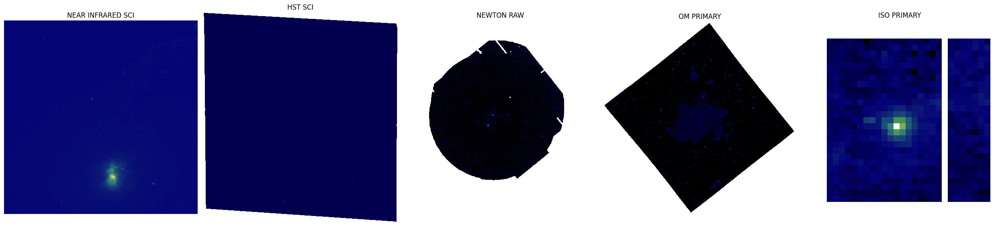

In [14]:
figure,axis = plt.subplots(1,5,figsize=(25,25))
    
axis[0].imshow(NI_SCI / 255.,cmap="gist_earth")
axis[0].set_title("NEAR INFRARED SCI")
axis[0].axis("off")
    
axis[1].imshow(HST_SCI / 255.,cmap="gist_earth")
axis[1].set_title("HST SCI")
axis[1].axis("off")
    
axis[2].imshow(NEWTON_RAW[2] / 255.,cmap="gist_earth")
axis[2].set_title("NEWTON RAW")
axis[2].axis("off")
    
axis[3].imshow(OM_PRIMARY / 255.,cmap="gist_earth")
axis[3].set_title("OM PRIMARY")
axis[3].axis("off")
    
axis[4].imshow(ISO_PRIMARY[1] / 255.,cmap="gist_earth")
axis[4].set_title("ISO PRIMARY")
axis[4].axis("off")
    
plt.tight_layout()
plt.show()

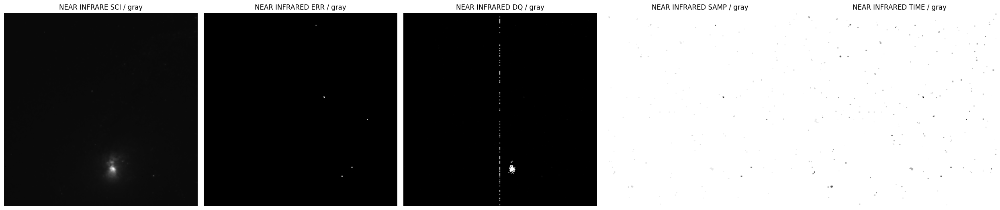

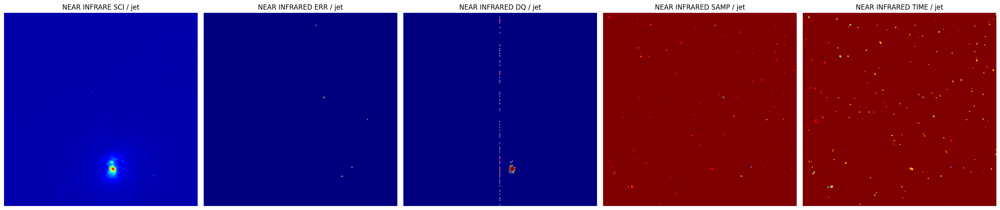

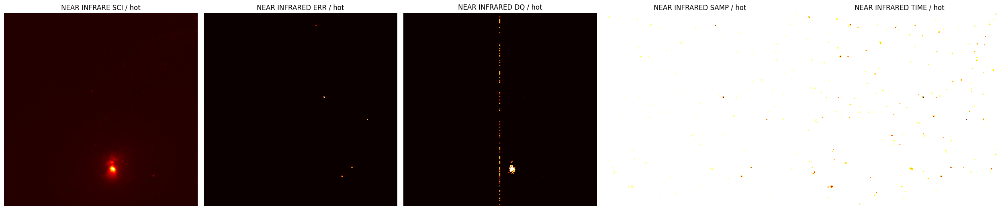

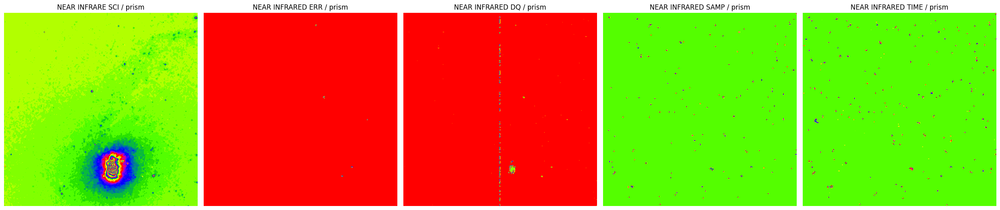

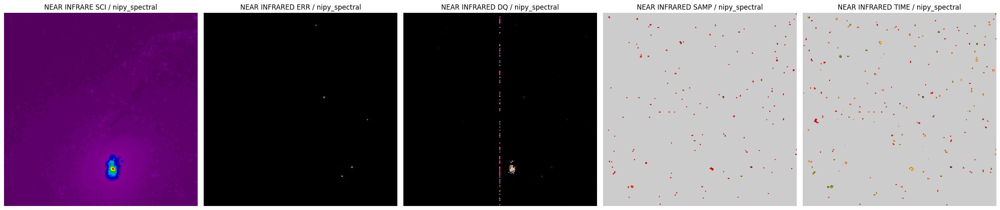

...

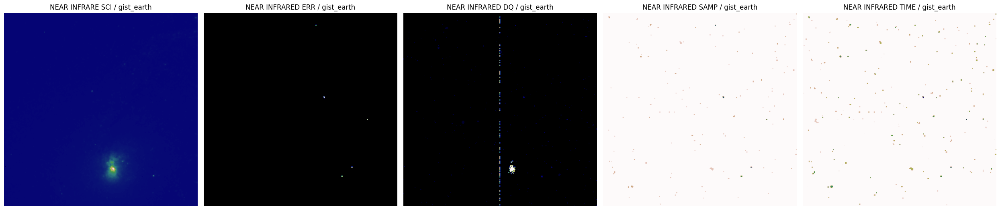

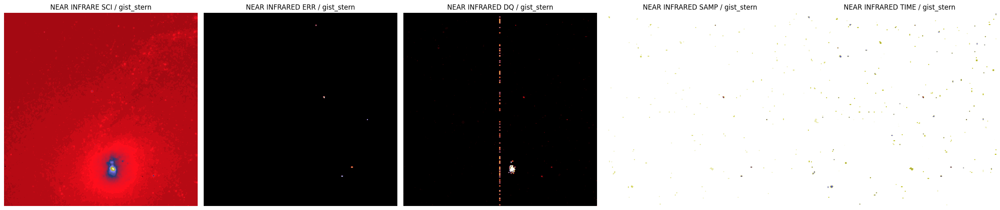

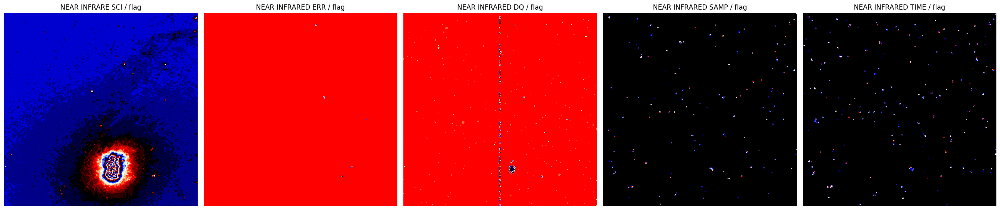

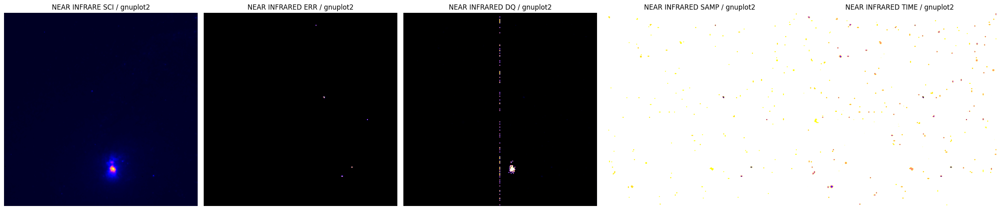

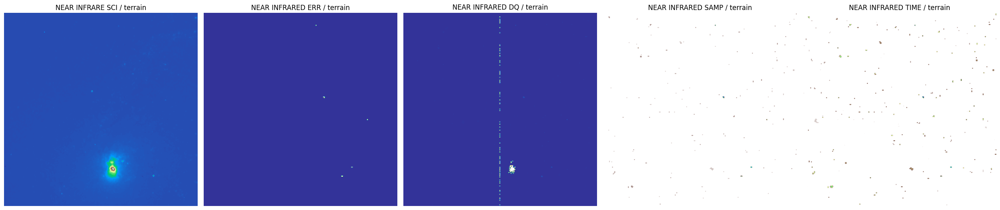

In [15]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,5,figsize=(25,25))
    
    axis[0].imshow(NI_SCI / 255.,cmap=x_spec) #TARGET
    axis[0].set_title("NEAR INFRARE SCI" + " / "+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(NI_ERR / 255.,cmap=x_spec)
    axis[1].set_title("NEAR INFRARED ERR" + " / "+ x_spec)
    axis[1].axis("off")
    
    axis[2].imshow(NI_DQ / 255.,cmap=x_spec)
    axis[2].set_title("NEAR INFRARED DQ" + " / "+ x_spec)
    axis[2].axis("off")
    
    axis[3].imshow(NI_SAMP / 255.,cmap=x_spec)
    axis[3].set_title("NEAR INFRARED SAMP" + " / "+ x_spec)
    axis[3].axis("off")
    
    axis[4].imshow(NI_TIME / 255.,cmap=x_spec)
    axis[4].set_title("NEAR INFRARED TIME" + " / "+ x_spec)
    axis[4].axis("off")
    
    plt.tight_layout()
    plt.show()


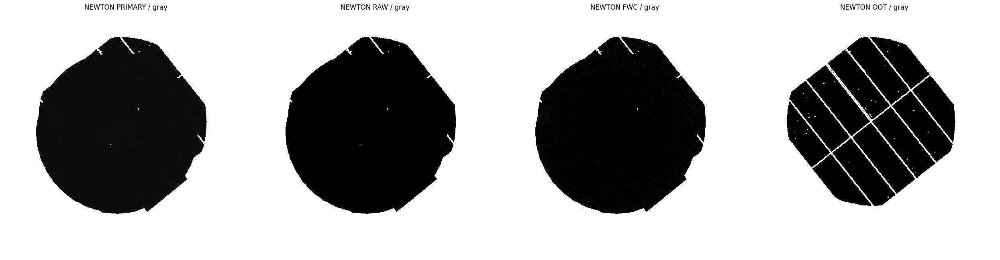

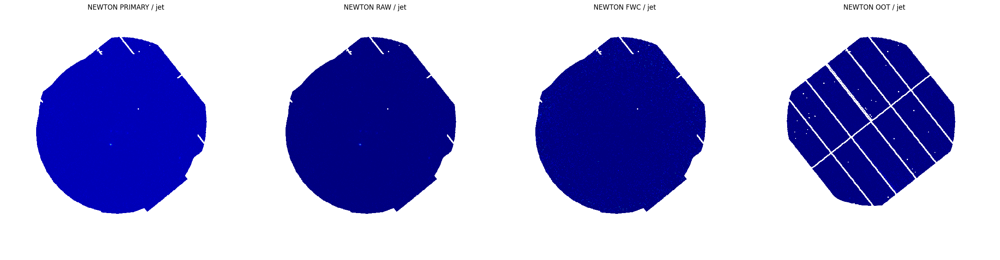

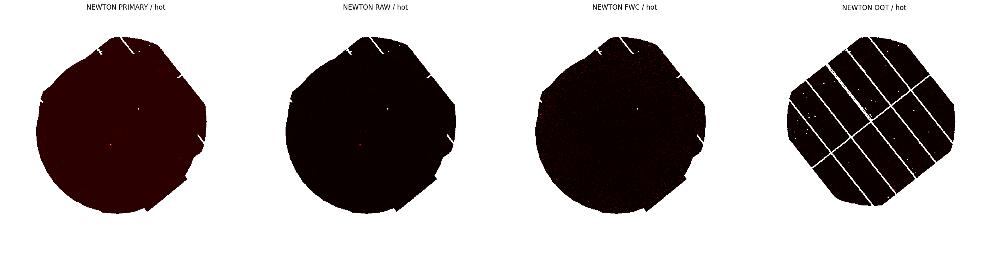

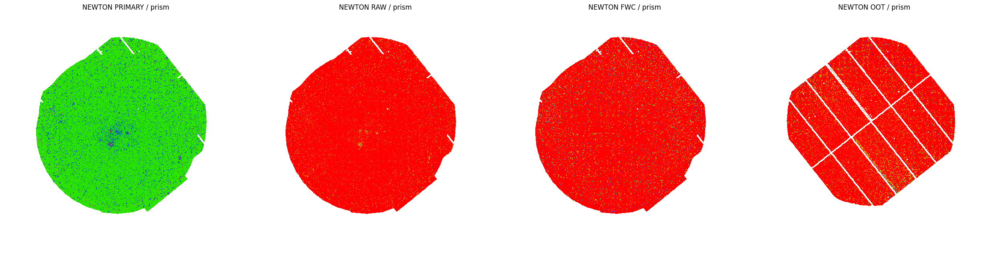

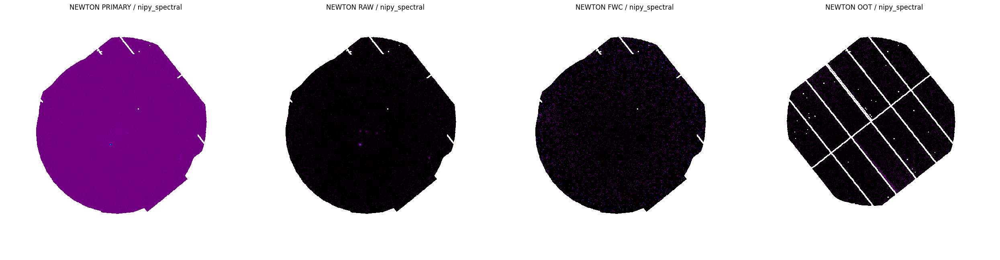

...

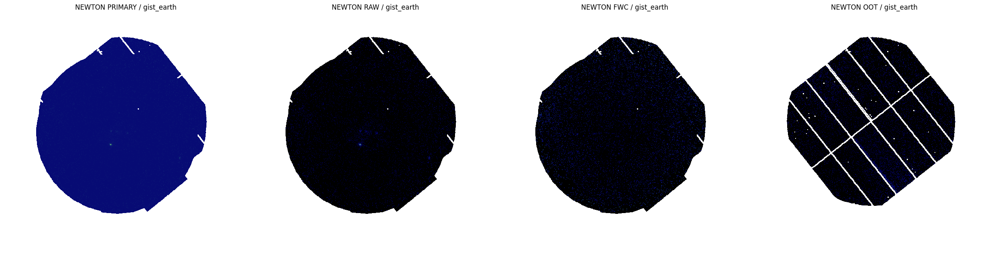

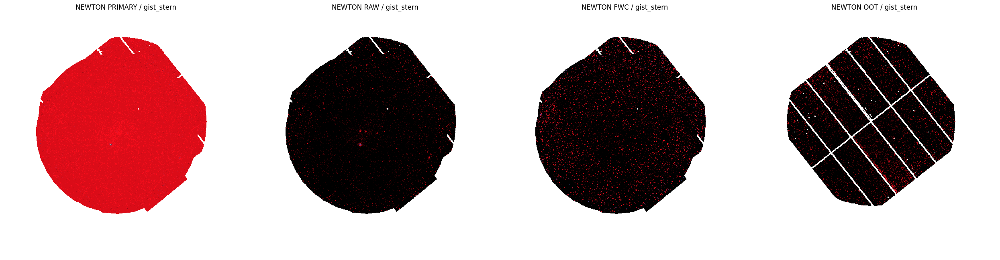

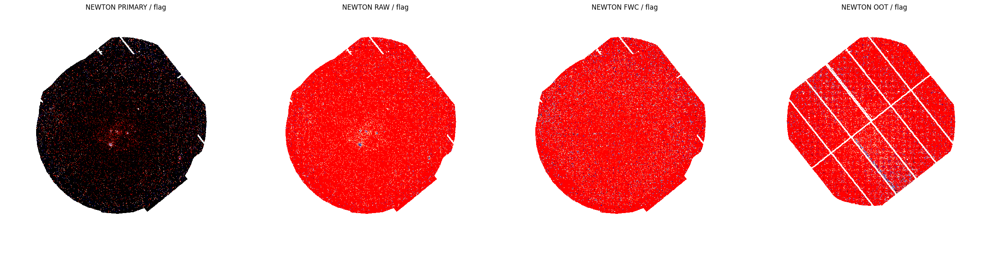

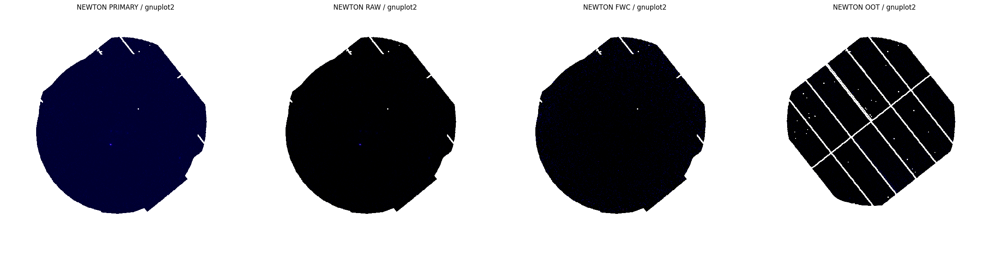

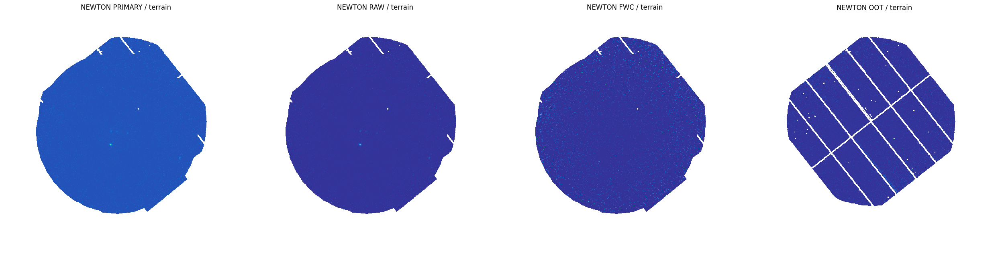

In [16]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,4,figsize=(25,25))
    
    axis[0].imshow(NEWTON_PRIMARY[0] / 255.,cmap=x_spec)
    axis[0].set_title("NEWTON PRIMARY" + " / "+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(NEWTON_RAW[0] / 255.,cmap=x_spec)  #TARGET
    axis[1].set_title("NEWTON RAW" + " / "+ x_spec)
    axis[1].axis("off")
    
    axis[2].imshow(NEWTON_FWC[0] / 255.,cmap=x_spec)
    axis[2].set_title("NEWTON FWC" + " / "+ x_spec)
    axis[2].axis("off")
    
    axis[3].imshow(NEWTON_OOT[0] / 255.,cmap=x_spec)
    axis[3].set_title("NEWTON OOT" + " / "+ x_spec)
    axis[3].axis("off")
    
    plt.tight_layout()
    plt.show()

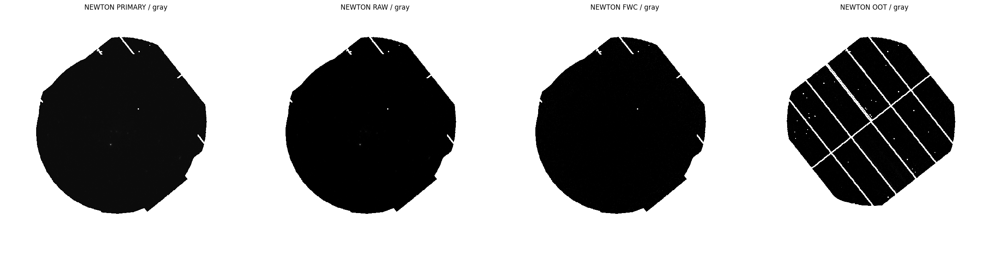

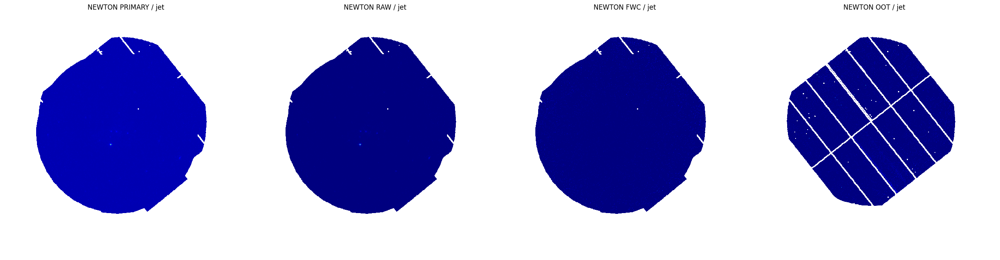

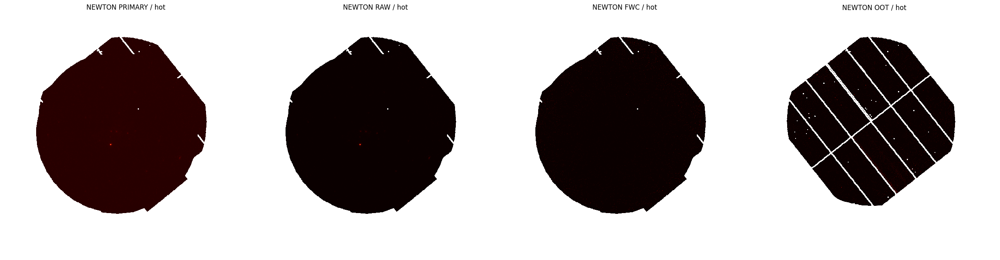

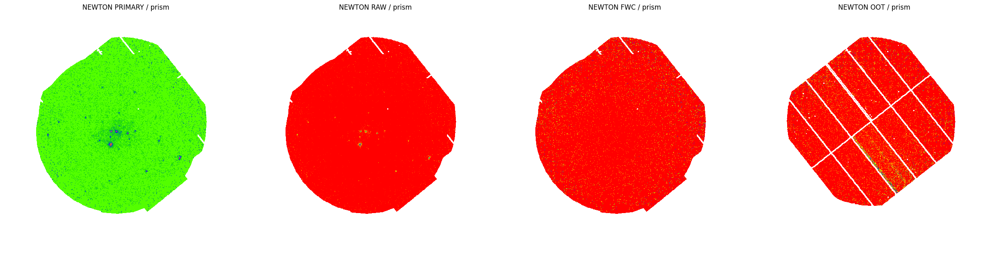

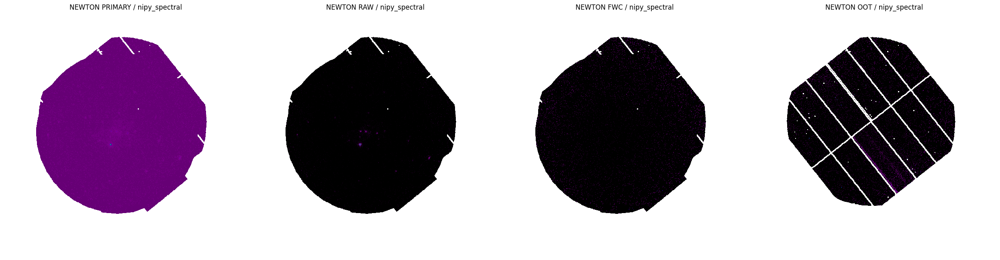

...

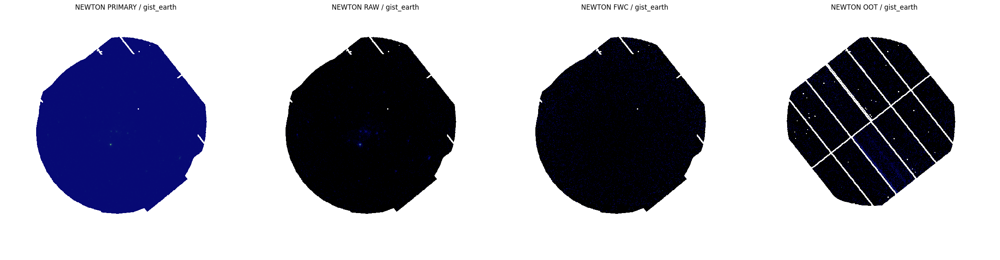

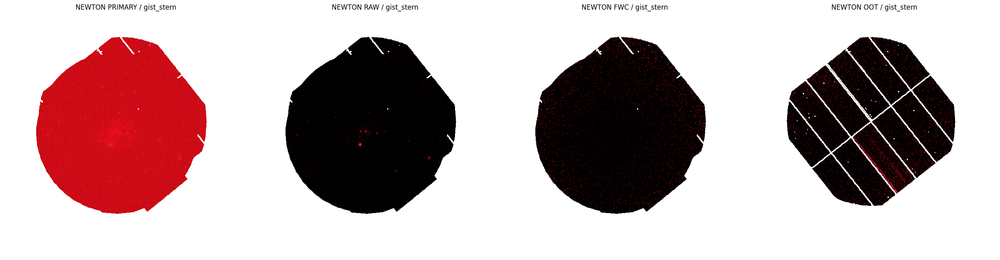

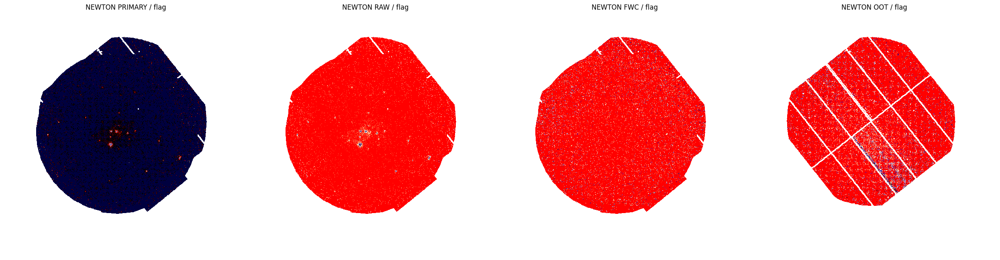

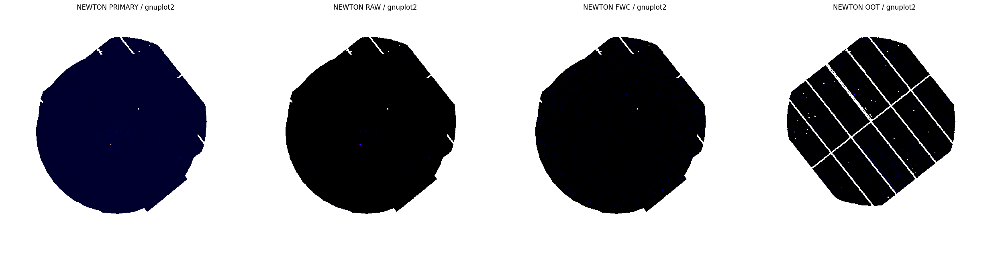

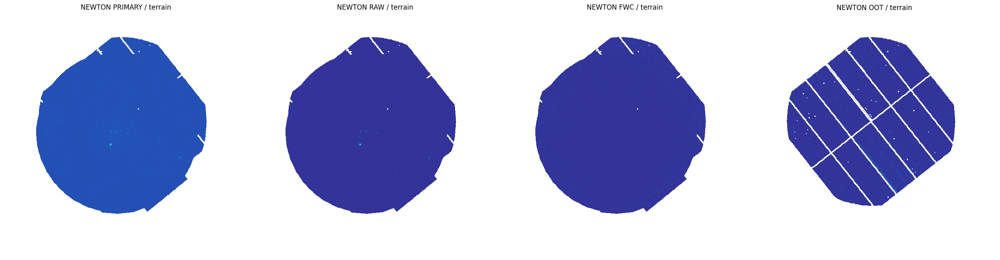

In [17]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,4,figsize=(25,25))
    
    axis[0].imshow(NEWTON_PRIMARY[1] / 255.,cmap=x_spec)
    axis[0].set_title("NEWTON PRIMARY" + " / "+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(NEWTON_RAW[1] / 255.,cmap=x_spec)  #TARGET
    axis[1].set_title("NEWTON RAW" + " / "+ x_spec)
    axis[1].axis("off")
    
    axis[2].imshow(NEWTON_FWC[1] / 255.,cmap=x_spec)
    axis[2].set_title("NEWTON FWC" + " / "+ x_spec)
    axis[2].axis("off")
    
    axis[3].imshow(NEWTON_OOT[1] / 255.,cmap=x_spec)
    axis[3].set_title("NEWTON OOT" + " / "+ x_spec)
    axis[3].axis("off")
    
    plt.tight_layout()
    plt.show()

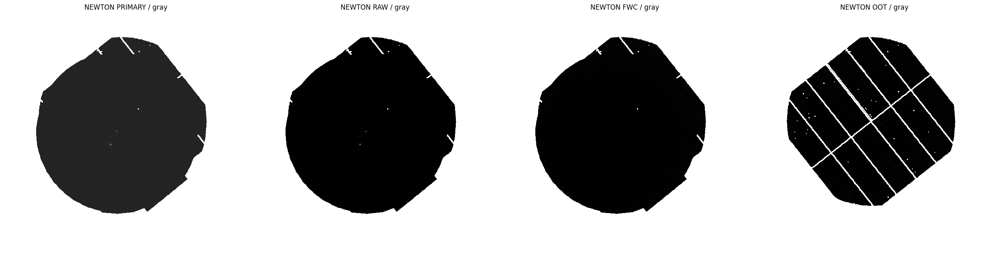

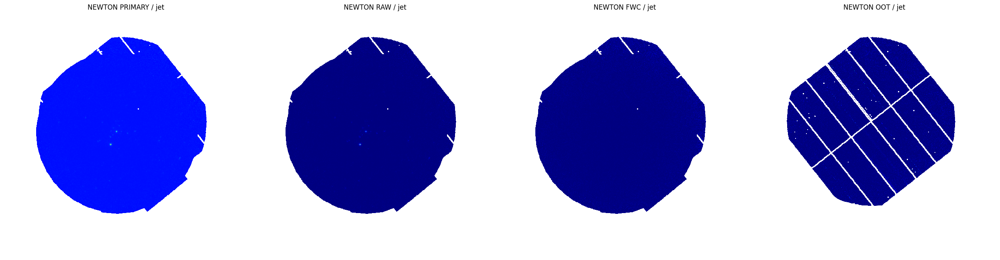

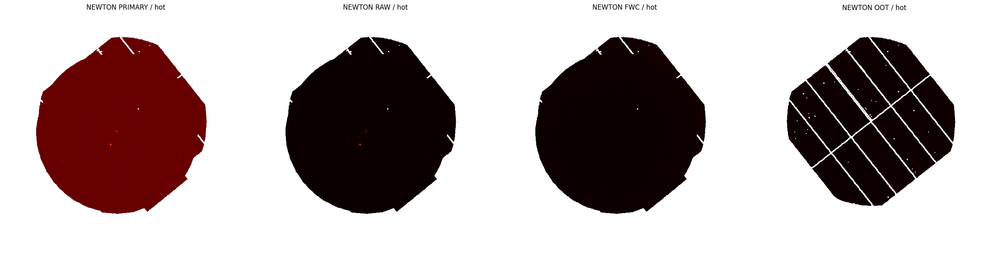

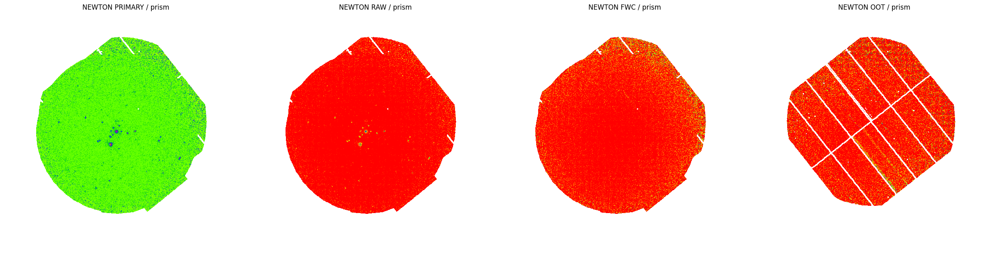

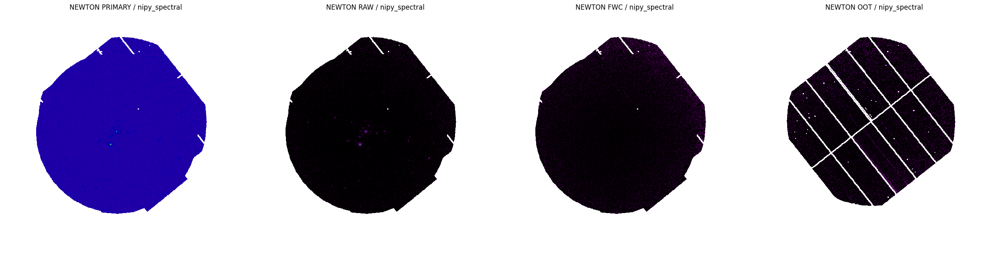

...

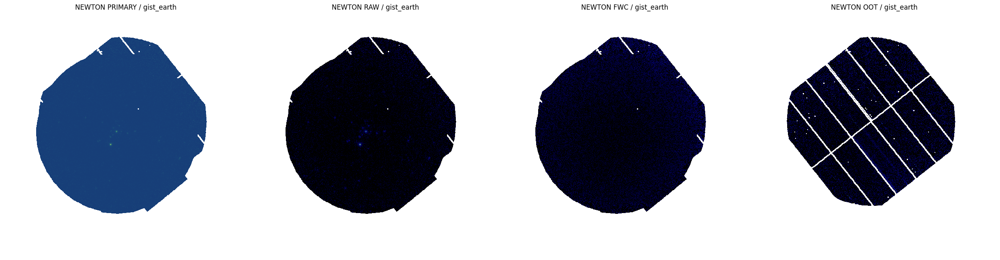

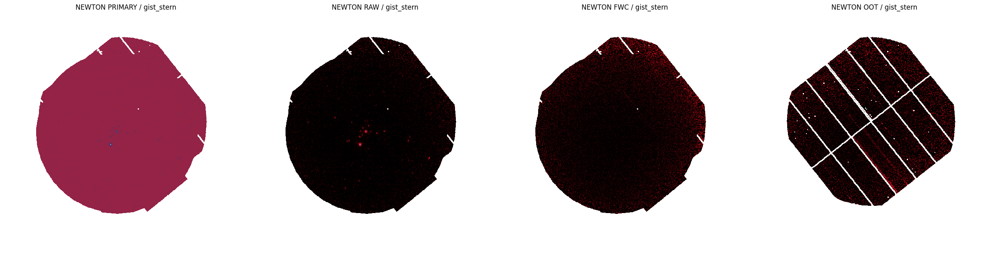

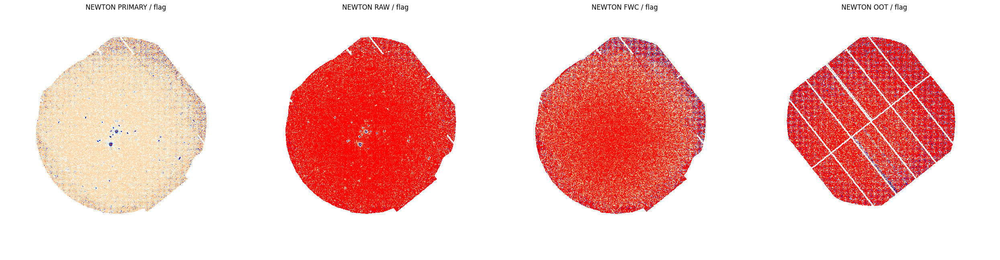

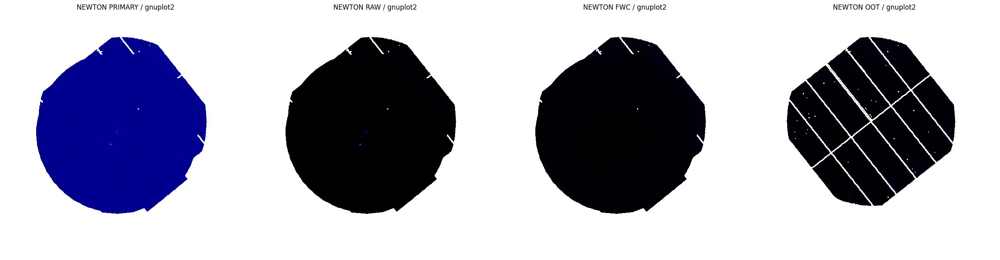

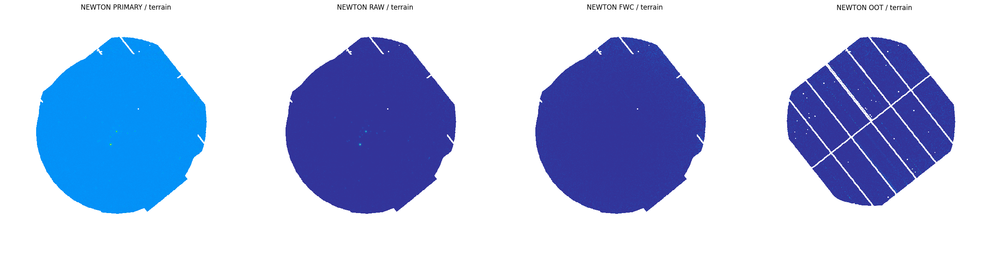

In [18]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,4,figsize=(25,25))
    
    axis[0].imshow(NEWTON_PRIMARY[2] / 255.,cmap=x_spec)
    axis[0].set_title("NEWTON PRIMARY" + " / "+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(NEWTON_RAW[2] / 255.,cmap=x_spec)  #TARGET
    axis[1].set_title("NEWTON RAW" + " / "+ x_spec)
    axis[1].axis("off")
    
    axis[2].imshow(NEWTON_FWC[2] / 255.,cmap=x_spec)
    axis[2].set_title("NEWTON FWC" + " / "+ x_spec)
    axis[2].axis("off")
    
    axis[3].imshow(NEWTON_OOT[2] / 255.,cmap=x_spec)
    axis[3].set_title("NEWTON OOT" + " / "+ x_spec)
    axis[3].axis("off")
    
    plt.tight_layout()
    plt.show()

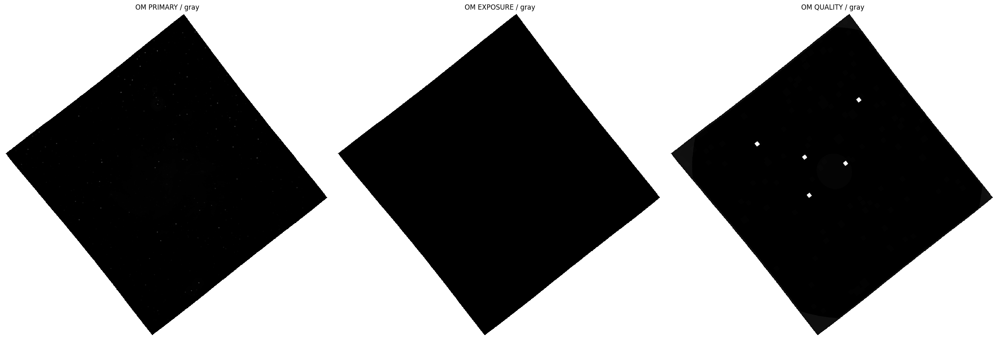

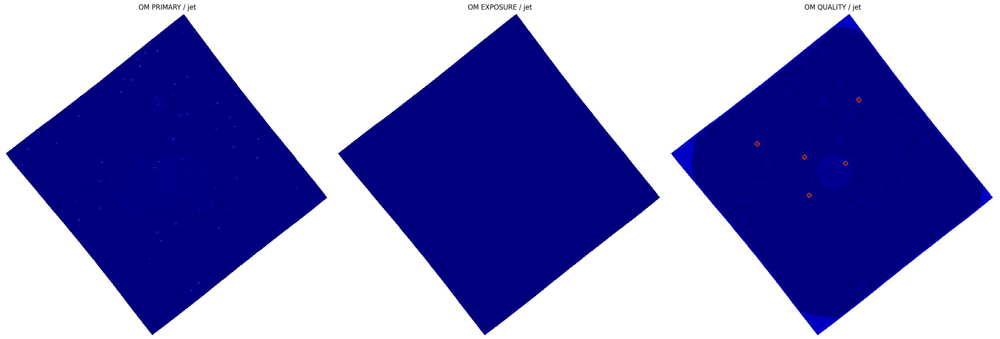

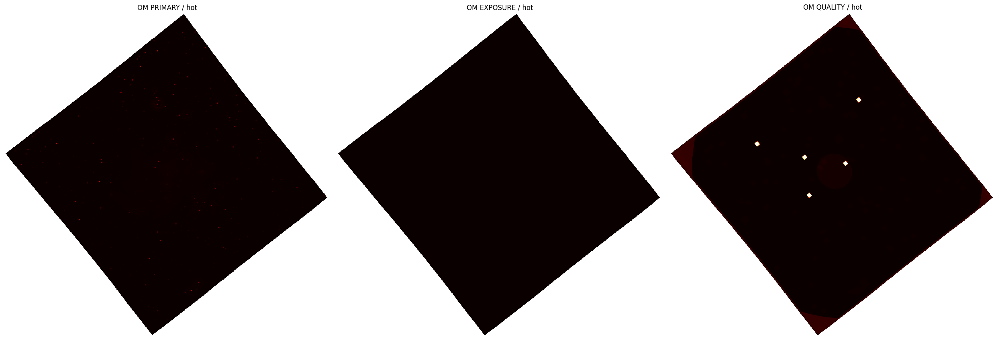

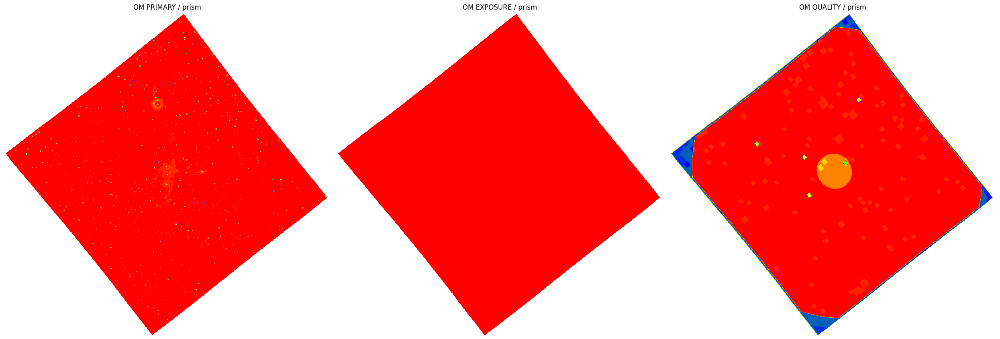

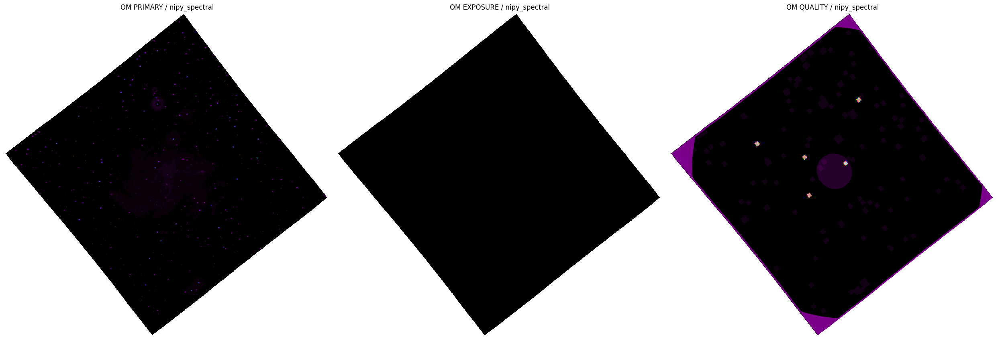

...

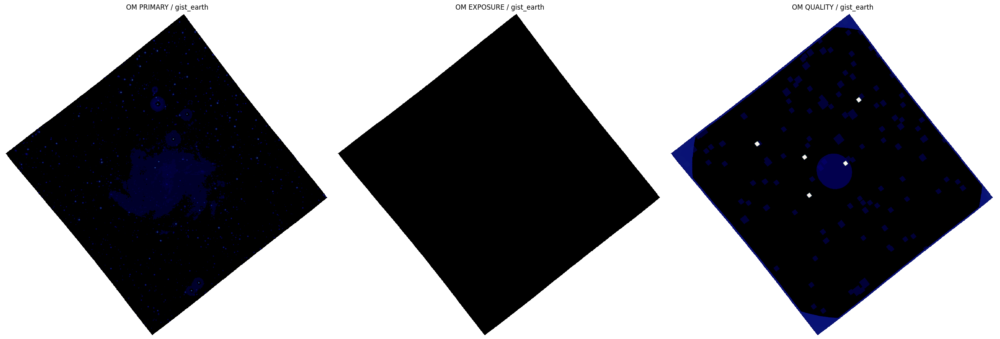

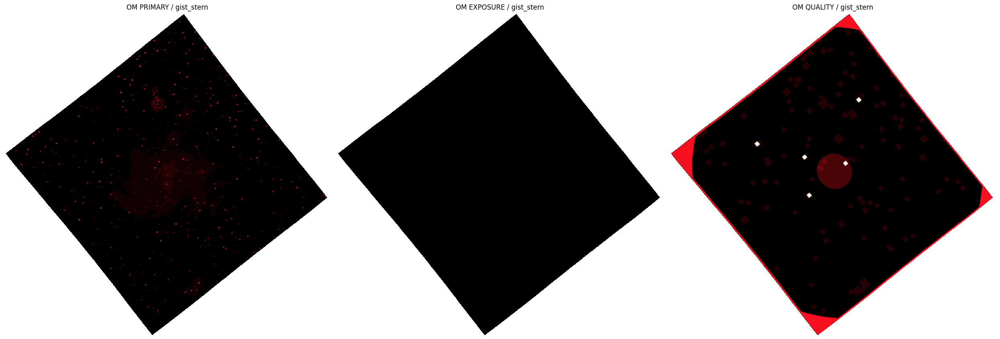

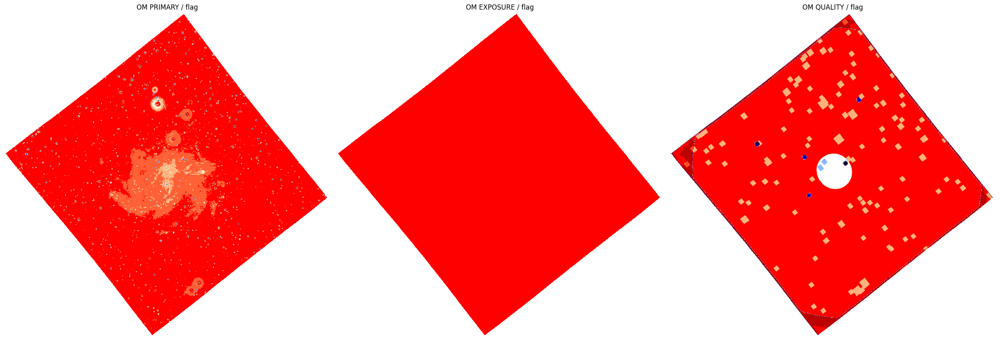

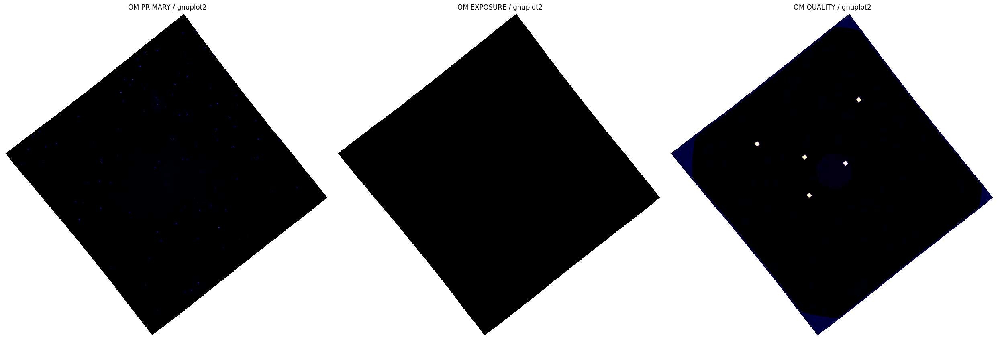

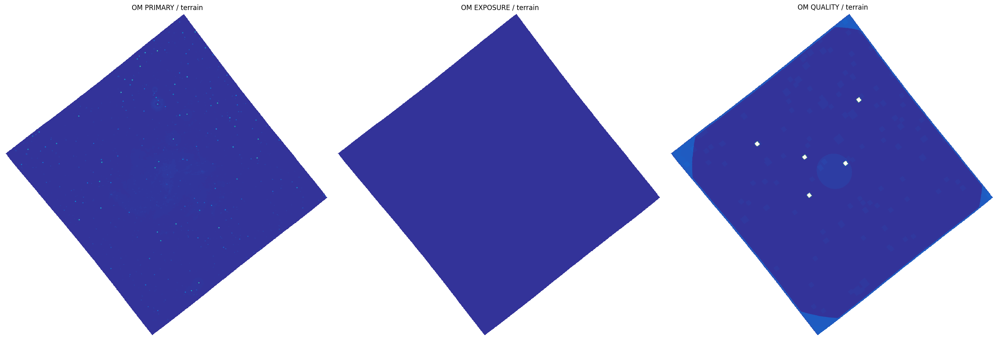

In [19]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,3,figsize=(25,25))
    
    axis[0].imshow(OM_PRIMARY / 255.,cmap=x_spec) #TARGET
    axis[0].set_title("OM PRIMARY" + " / "+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(OM_EXPOSURE / 255.,cmap=x_spec)
    axis[1].set_title("OM EXPOSURE" + " / "+ x_spec)
    axis[1].axis("off")
    
    axis[2].imshow(OM_QUALITY / 255.,cmap=x_spec)
    axis[2].set_title("OM QUALITY" + " / "+ x_spec)
    axis[2].axis("off")
    
    plt.tight_layout()
    plt.show()

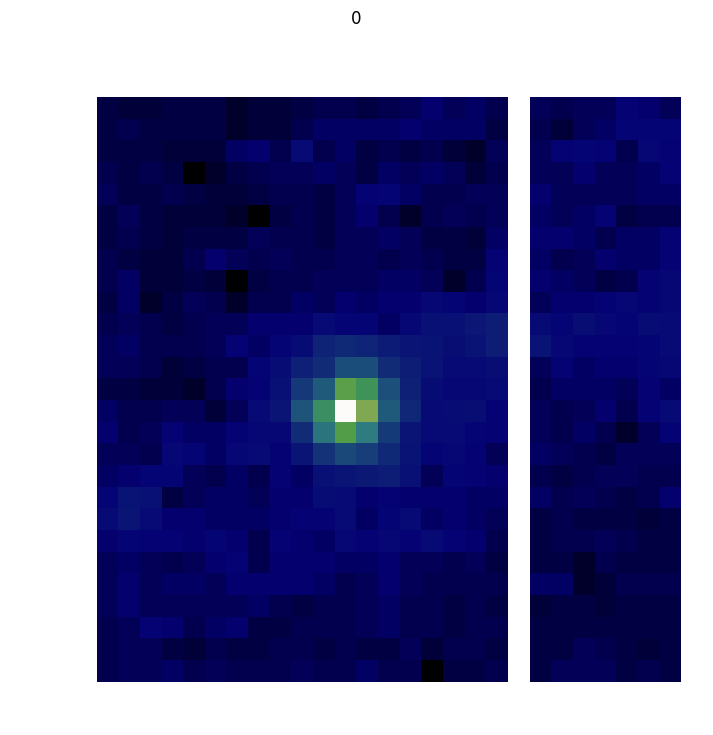

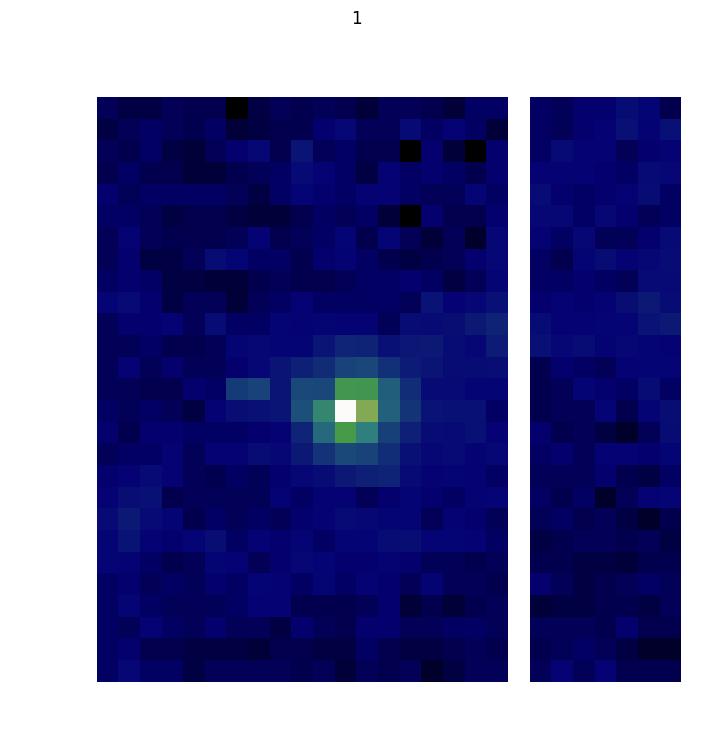

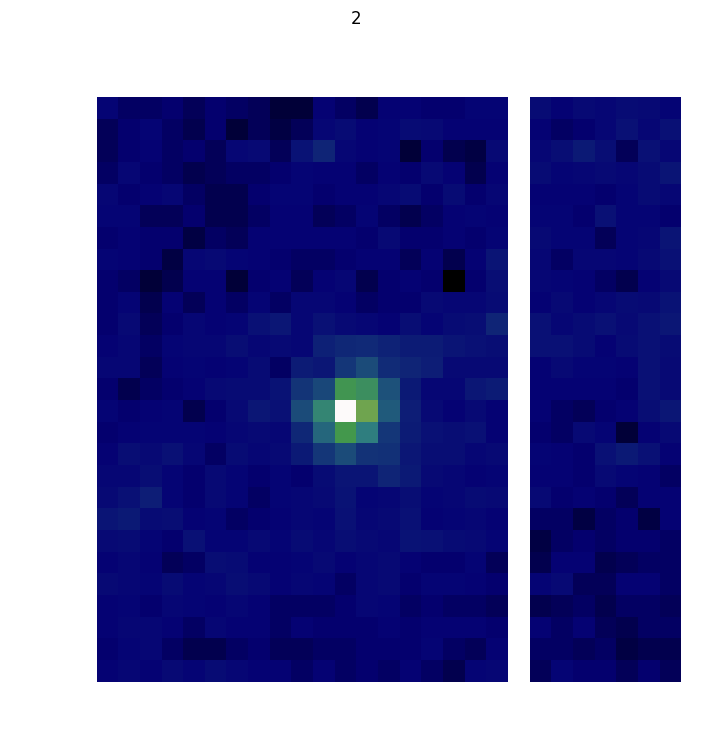

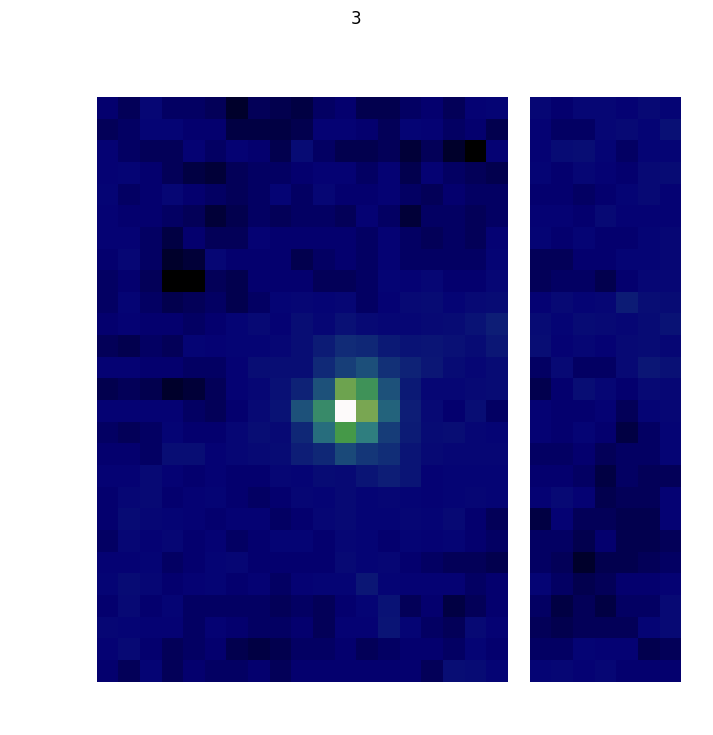

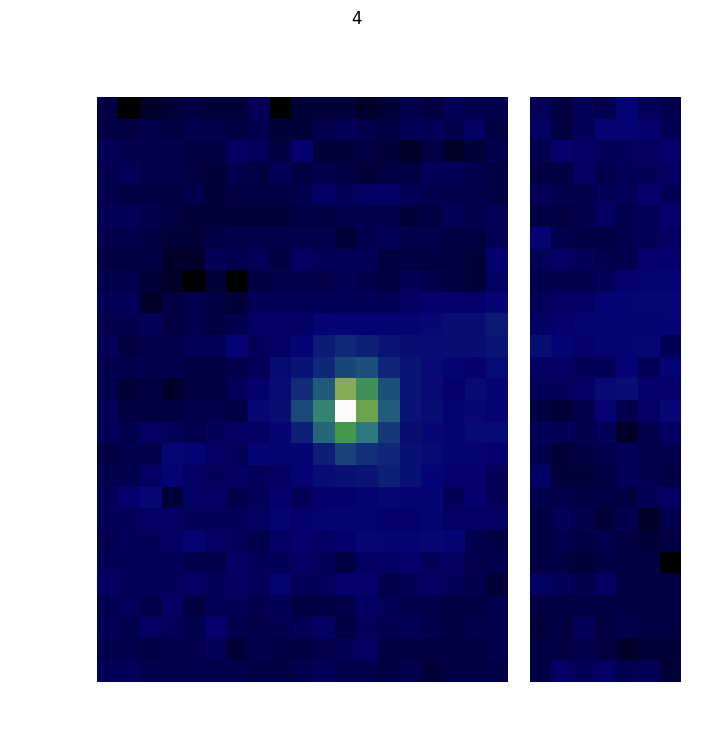

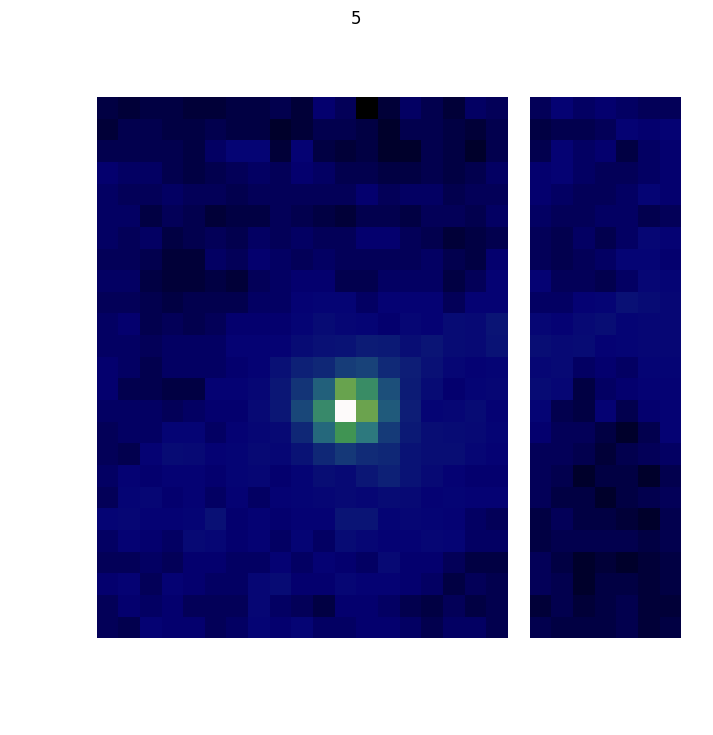

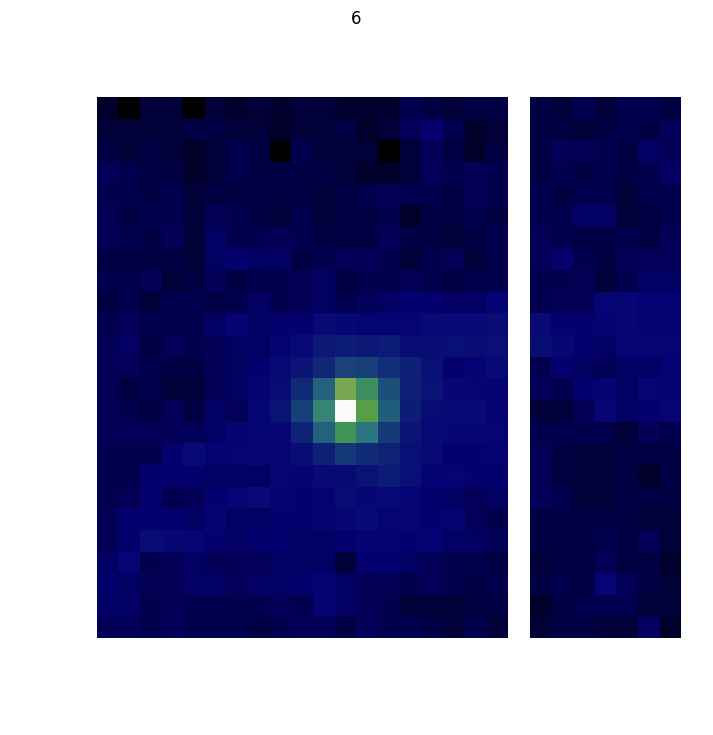

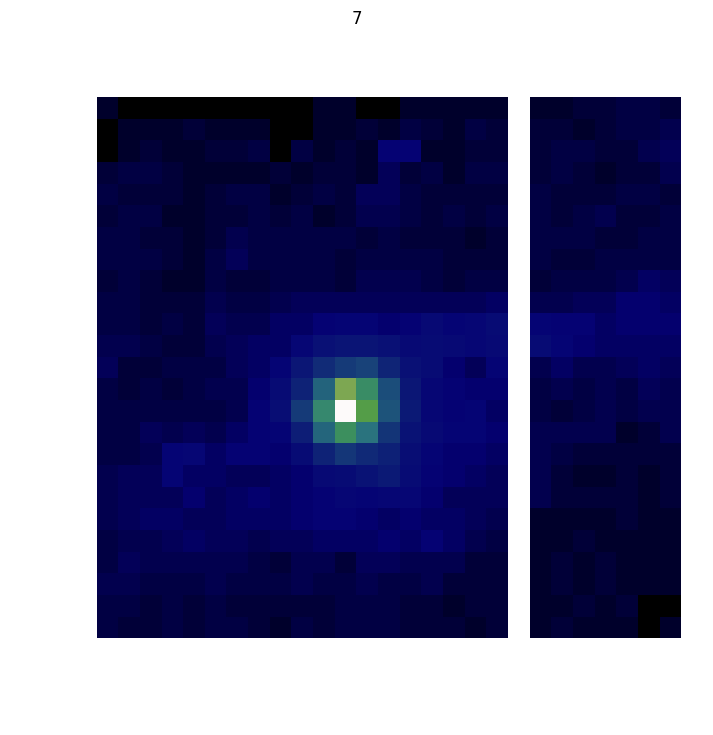

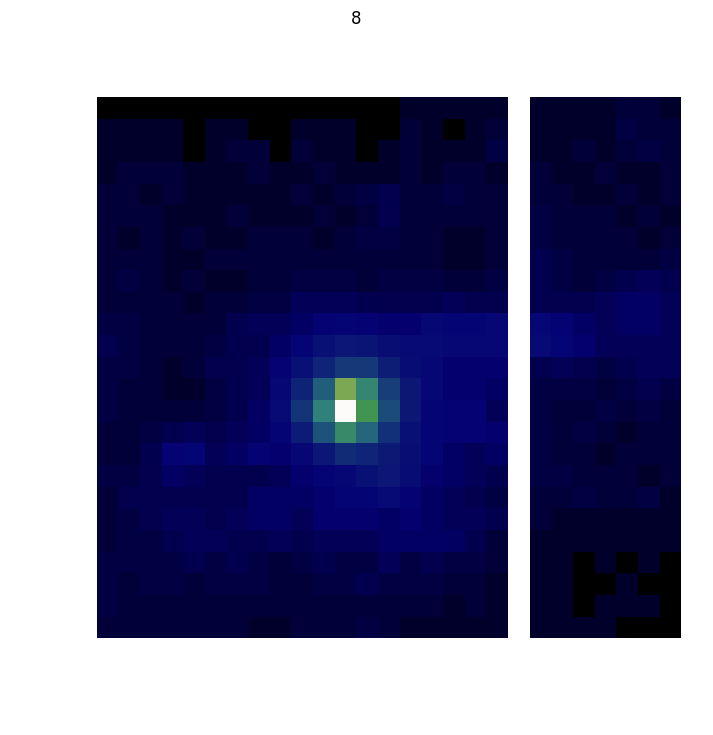

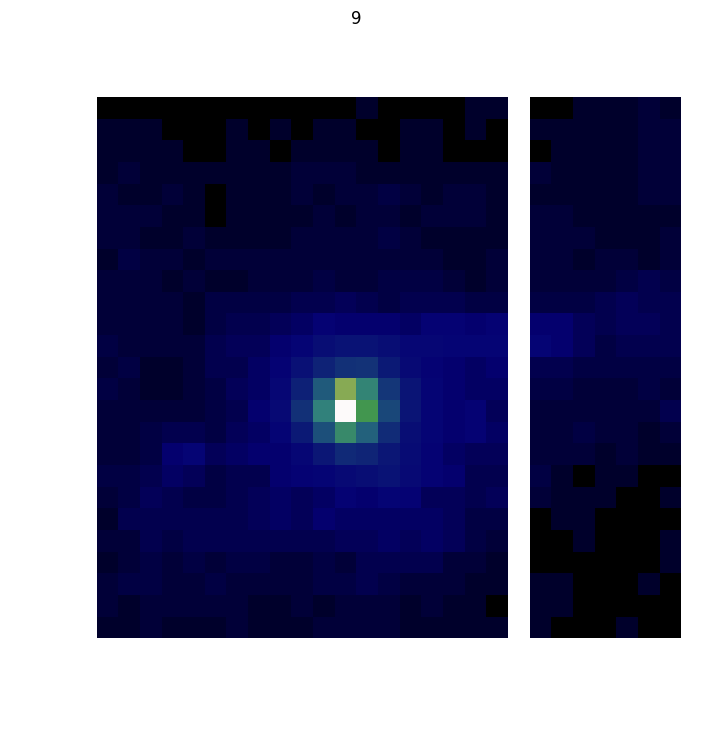

In [20]:
for i_count in range(10):
    
    plt.figure(figsize=(9,9))
    plt.title(str(i_count))
    plt.axis("off")
    plt.imshow(ISO_PRIMARY[i_count],cmap="gist_earth")
    plt.show()
    
    # TARGET ISO_PRIMARY[1]

#### Selecting specific scale to visualize nucleus and manual interpretation

In [21]:
WIDE_SCALE_NI = NI_SCI[90:,60:220]
ZOOMED_SCALE_NI = NI_SCI[150:,95:195]
NUCLEUS_SCALE_NI = NI_SCI[190:220,120:165]

WIDE_SCALE_HST = HST_SCI[700:4000,700:4000]
ZOOMED_SCALE_HST = HST_SCI[1800:3400,1700:3200]
ZOOMED_X2_SCALE_HST = HST_SCI[2100:3100,2000:3000]
ZOOMED_X3_SCALE_HST = HST_SCI[2450:2850,2300:2700]
NUCLEUS_SCALE_HST = HST_SCI[2640:2850,2330:2650]

WIDE_SCALE_NEWTON = NEWTON_RAW[2][155:480,160:440]
ZOOMED_SCALE_NEWTON = NEWTON_RAW[2][200:400,200:380]
NUCLEUS_SCALE_NEWTON = NEWTON_RAW[2][270:370,240:340]

WIDE_SCALE_OM = OM_PRIMARY[480:1070,350:1195]
ZOOMED_SCALE_OM = OM_PRIMARY[370:1055,420:1070]
NUCLEUS_SCALE_OM = OM_PRIMARY[500:950,500:950]

ISO_CONS_SCALE = ISO_PRIMARY[1][:,7:22]

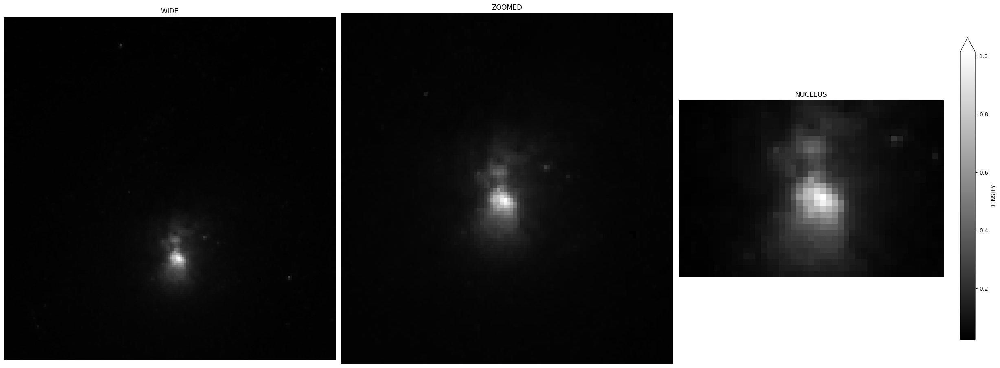

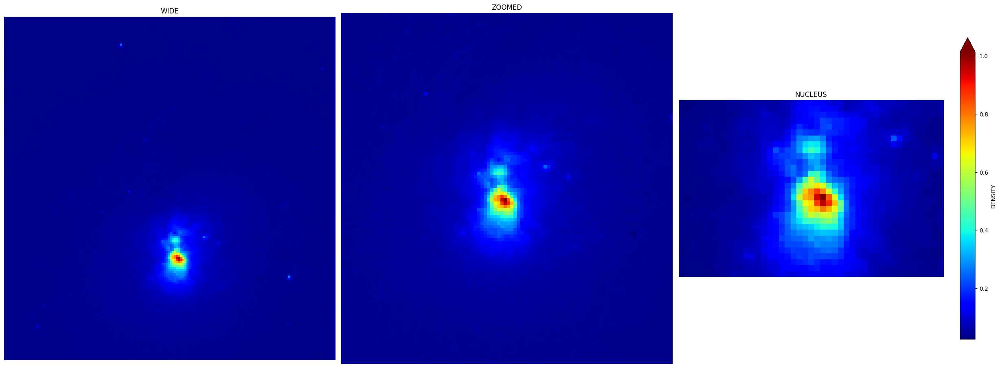

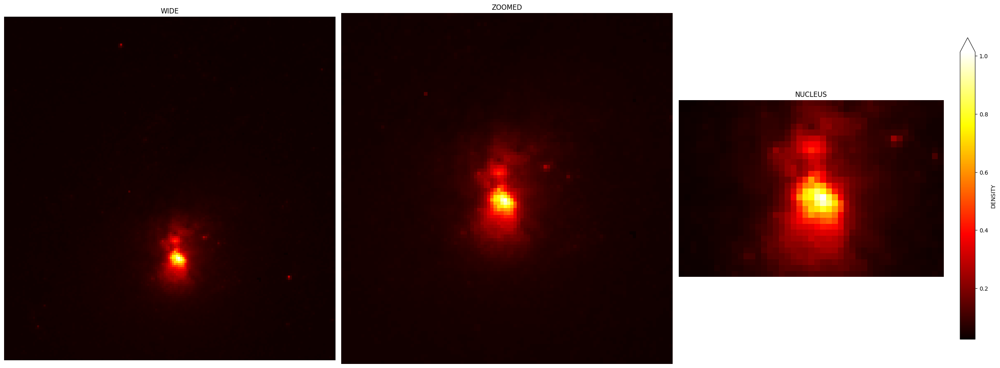

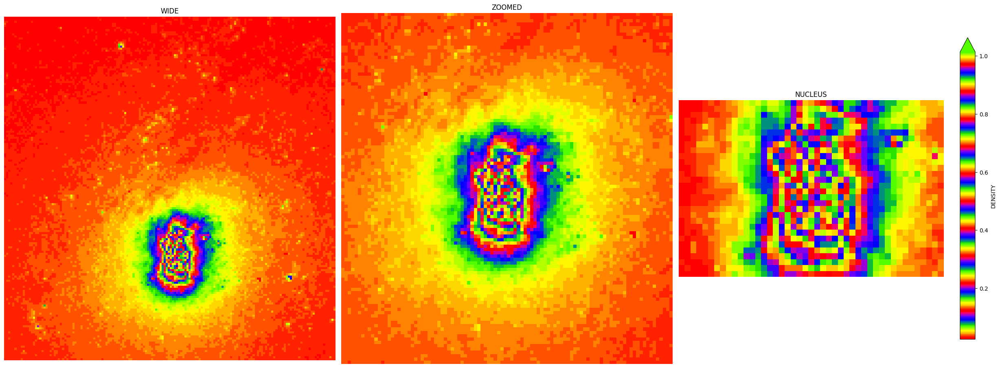

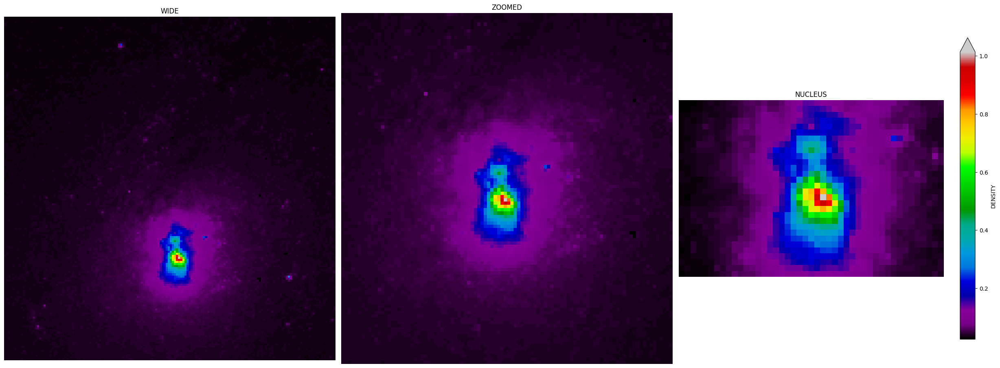

...

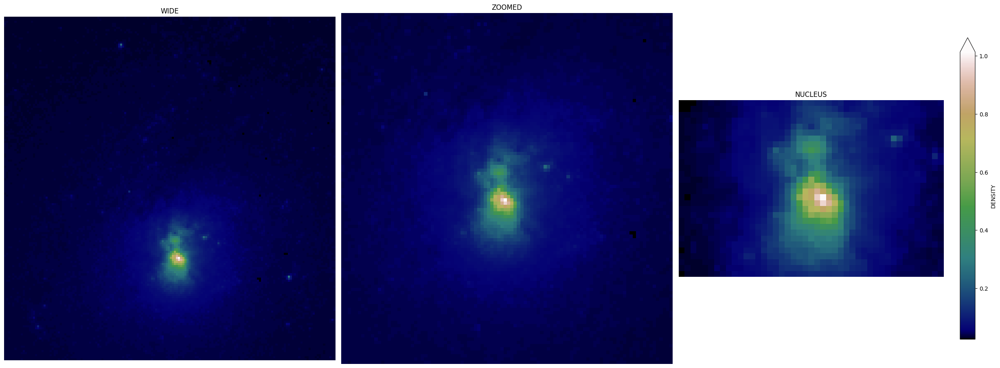

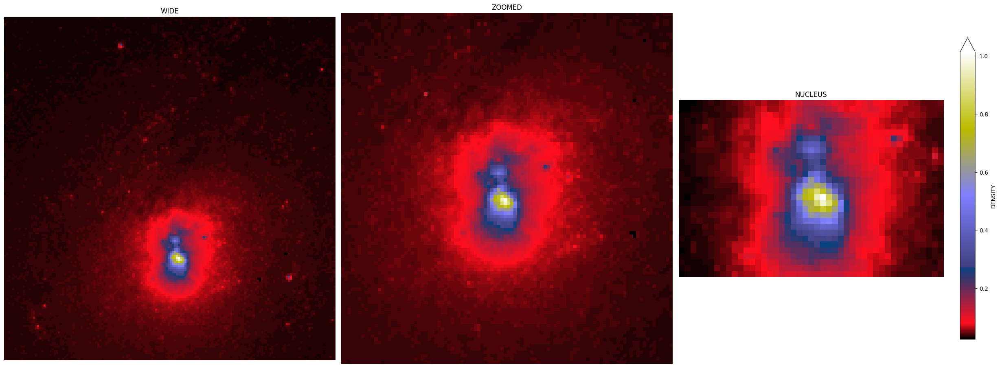

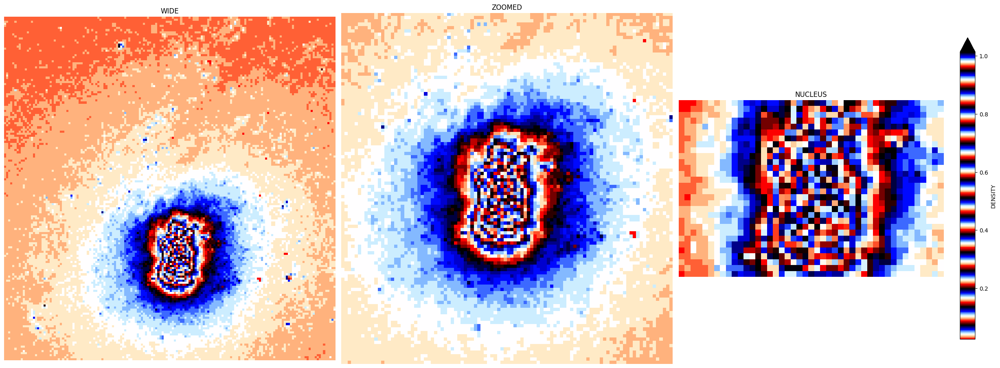

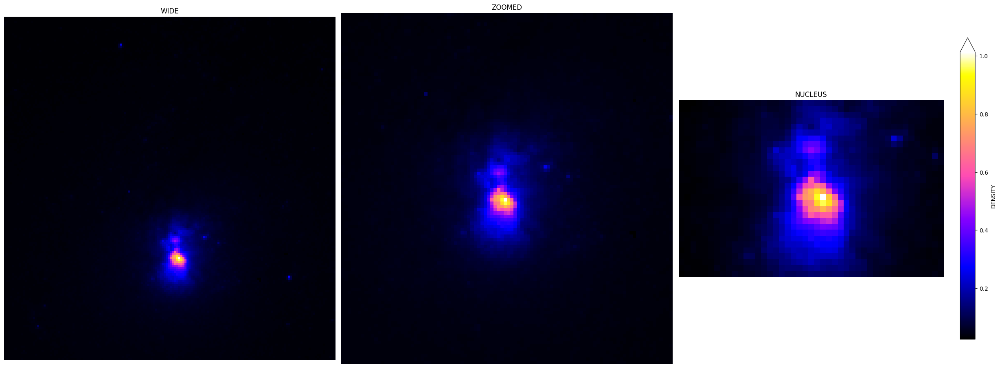

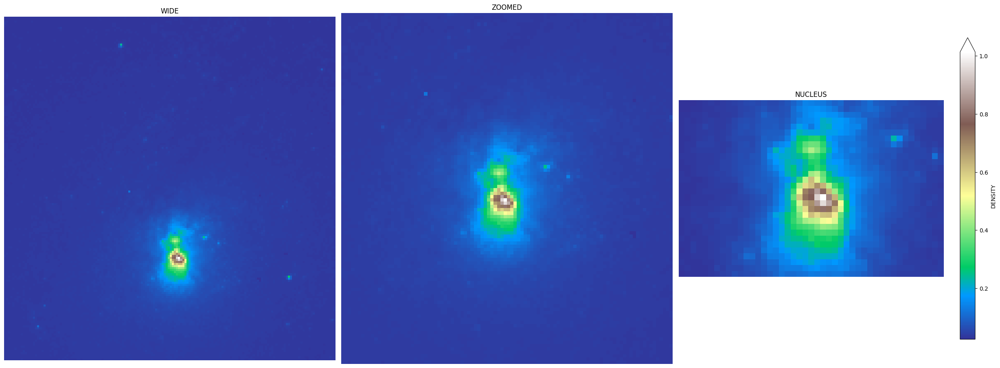

In [22]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,3,figsize=(25,25))

    axis[0].imshow(WIDE_SCALE_NI / 255.,cmap=x_spec)
    axis[0].set_title("WIDE")
    axis[0].axis("off")

    axis[1].imshow(ZOOMED_SCALE_NI / 255.,cmap=x_spec)
    axis[1].set_title("ZOOMED")
    axis[1].axis("off")

    DENSITY_FUNC = axis[2].imshow(NUCLEUS_SCALE_NI / 255.,cmap=x_spec)
    axis[2].set_title("NUCLEUS")
    axis[2].axis("off")

    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

# SATO FILTER

In [23]:
SATO_WIDE_SCALE_NI = filters.sato(WIDE_SCALE_NI)
SATO_ZOOMED_SCALE_NI = filters.sato(ZOOMED_SCALE_NI)
SATO_NUCLEUS_SCALE_NI = filters.sato(NUCLEUS_SCALE_NI)

SATO_WIDE_SCALE_HST = filters.sato(WIDE_SCALE_HST)
SATO_ZOOMED_SCALE_HST = filters.sato(ZOOMED_SCALE_HST)
SATO_ZOOMED_X2_SCALE_HST = filters.sato(ZOOMED_X2_SCALE_HST)
SATO_ZOOMED_X3_SCALE_HST = filters.sato(ZOOMED_X3_SCALE_HST)
SATO_NUCLEUS_SCALE_HST = filters.sato(NUCLEUS_SCALE_HST)

SATO_WIDE_SCALE_NEWTON = filters.sato(WIDE_SCALE_NEWTON)
SATO_ZOOMED_SCALE_NEWTON = filters.sato(ZOOMED_SCALE_NEWTON)
SATO_NUCLEUS_SCALE_NEWTON = filters.sato(NUCLEUS_SCALE_NEWTON)

SATO_WIDE_SCALE_OM = filters.sato(WIDE_SCALE_OM)
SATO_ZOOMED_SCALE_OM = filters.sato(ZOOMED_SCALE_OM)
SATO_NUCLEUS_SCALE_OM = filters.sato(NUCLEUS_SCALE_OM)

SATO_ISO_CONS_SCALE = filters.sato(ISO_CONS_SCALE)

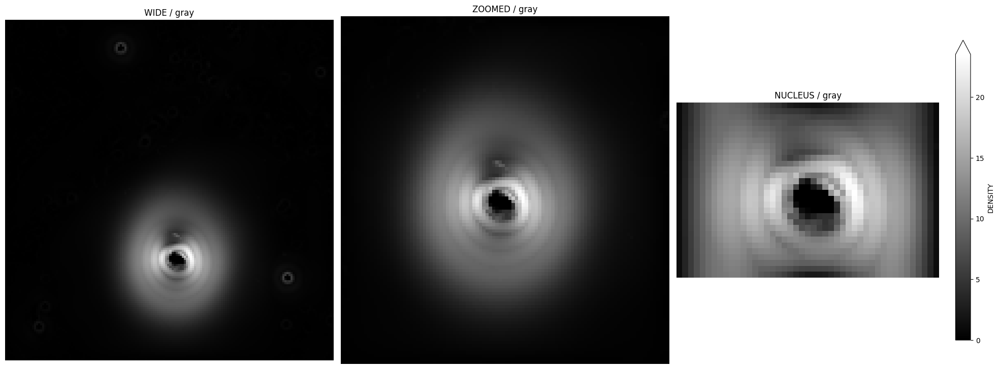

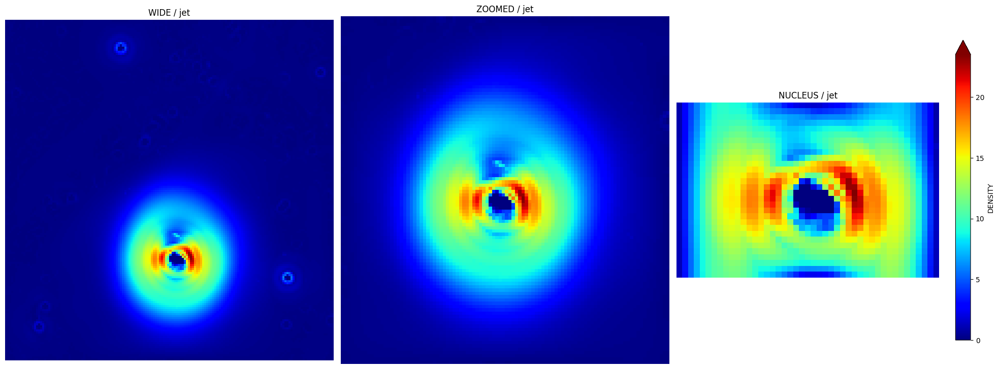

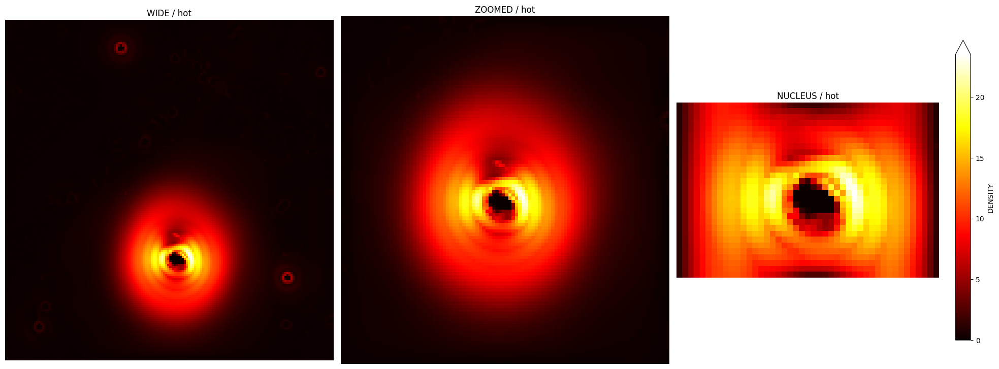

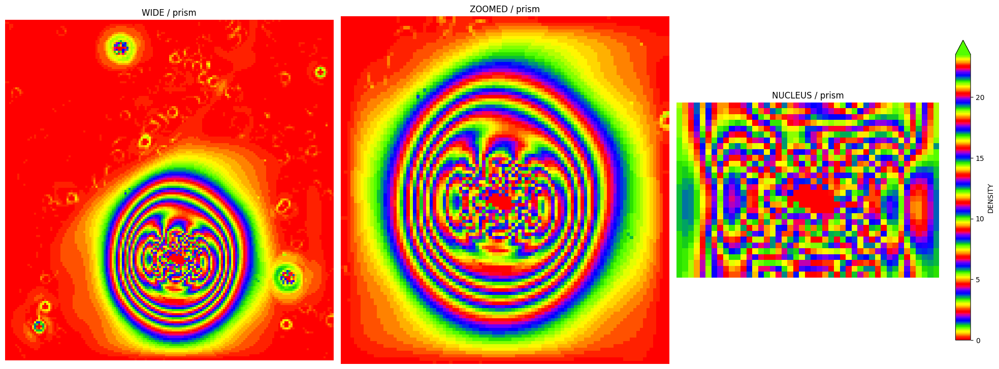

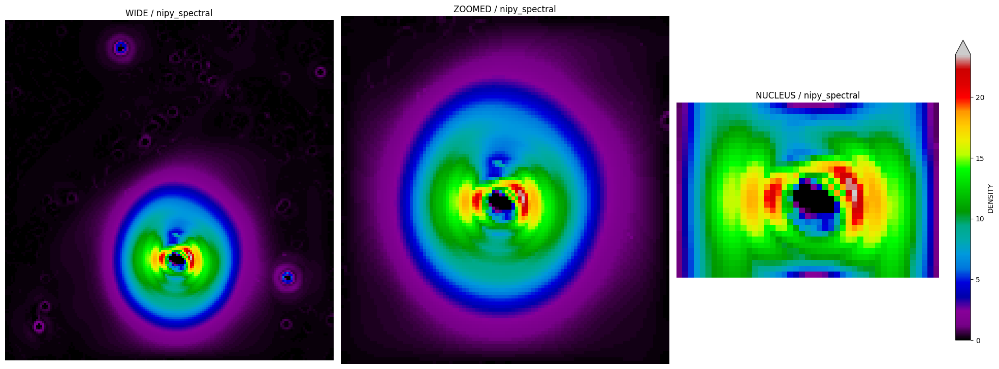

...

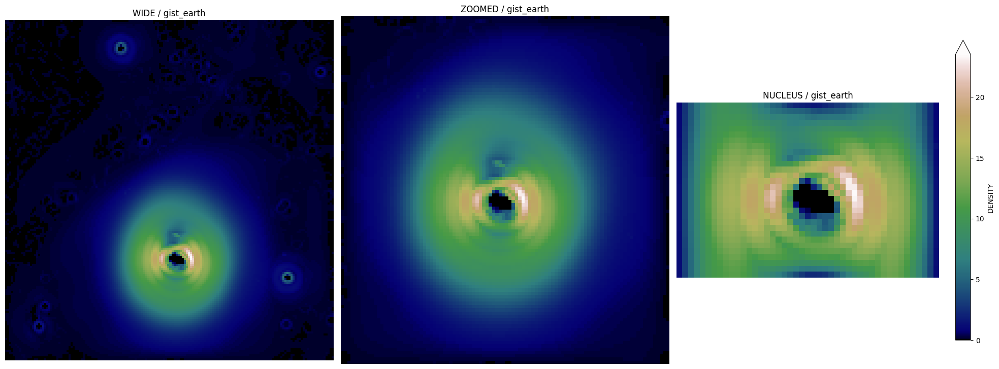

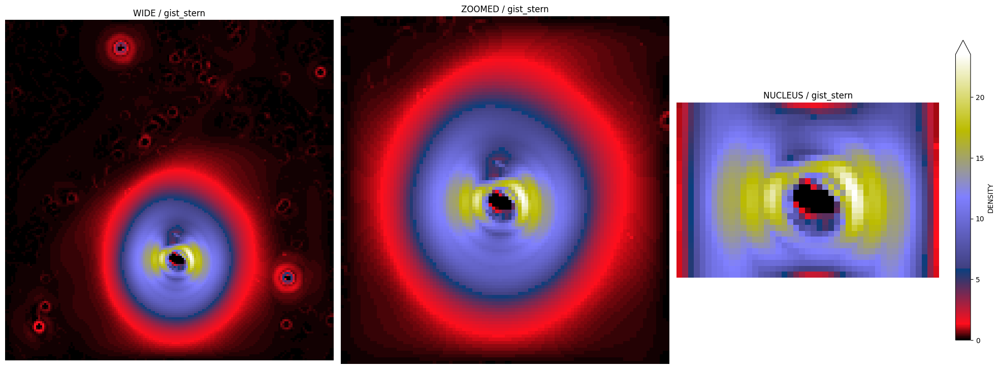

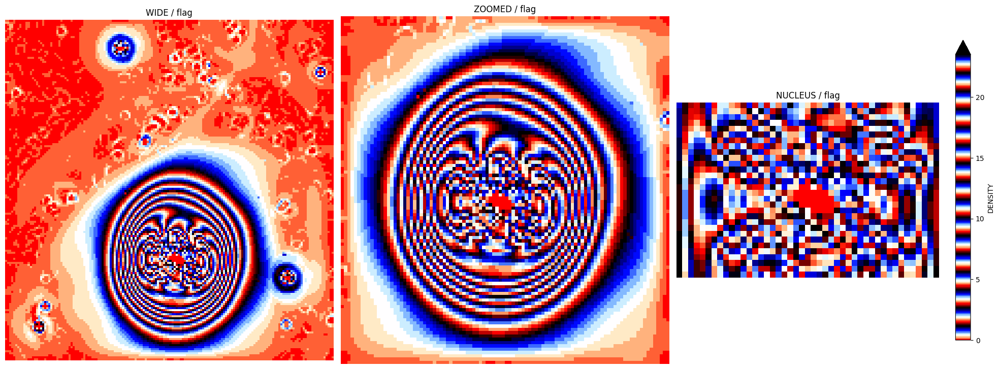

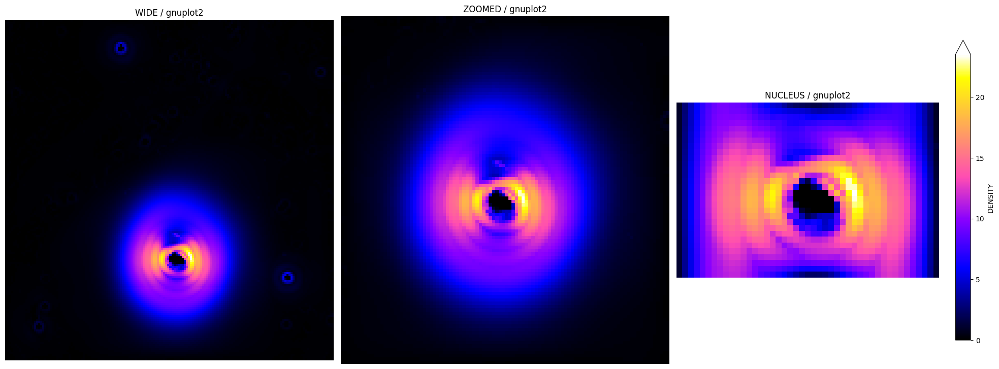

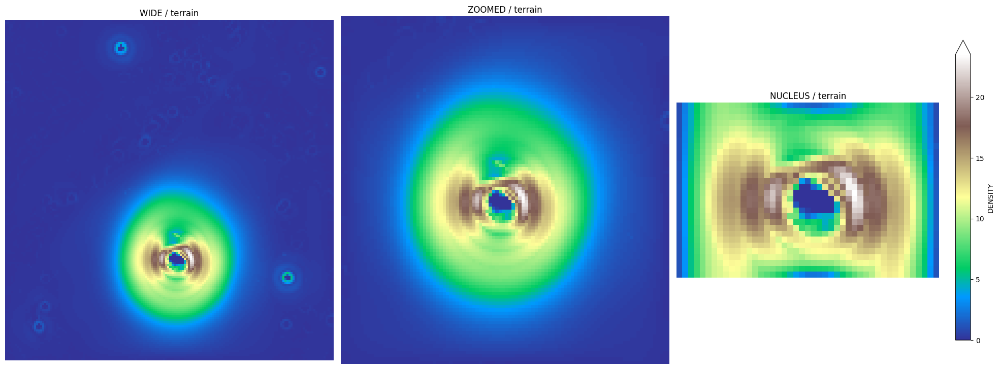

In [24]:

for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,3,figsize=(20,20))
    
    axis[0].imshow(SATO_WIDE_SCALE_NI,cmap=x_spec)
    axis[0].set_title("WIDE" + " / "+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(SATO_ZOOMED_SCALE_NI,cmap=x_spec)
    axis[1].set_title("ZOOMED" + " / "+ x_spec)
    axis[1].axis("off")
    
    DENSITY_FUNC = axis[2].imshow(SATO_NUCLEUS_SCALE_NI,cmap=x_spec)
    axis[2].set_title("NUCLEUS" + " / "+ x_spec)
    axis[2].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

# MEIJERING FILTER

In [25]:
M_WIDE_SCALE_NI = filters.meijering(WIDE_SCALE_NI)
M_ZOOMED_SCALE_NI = filters.meijering(ZOOMED_SCALE_NI)
M_NUCLEUS_SCALE_NI = filters.meijering(NUCLEUS_SCALE_NI)

M_WIDE_SCALE_HST = filters.meijering(WIDE_SCALE_HST)
M_ZOOMED_SCALE_HST = filters.meijering(ZOOMED_SCALE_HST)
M_ZOOMED_X2_SCALE_HST = filters.meijering(ZOOMED_X2_SCALE_HST)
M_ZOOMED_X3_SCALE_HST = filters.meijering(ZOOMED_X3_SCALE_HST)
M_NUCLEUS_SCALE_HST = filters.meijering(NUCLEUS_SCALE_HST)

M_WIDE_SCALE_NEWTON = filters.meijering(WIDE_SCALE_NEWTON)
M_ZOOMED_SCALE_NEWTON = filters.meijering(ZOOMED_SCALE_NEWTON)
M_NUCLEUS_SCALE_NEWTON = filters.meijering(NUCLEUS_SCALE_NEWTON)

M_WIDE_SCALE_OM = filters.meijering(WIDE_SCALE_OM)
M_ZOOMED_SCALE_OM = filters.meijering(ZOOMED_SCALE_OM)
M_NUCLEUS_SCALE_OM = filters.meijering(NUCLEUS_SCALE_OM)

M_ISO_CONS_SCALE = filters.meijering(ISO_CONS_SCALE)

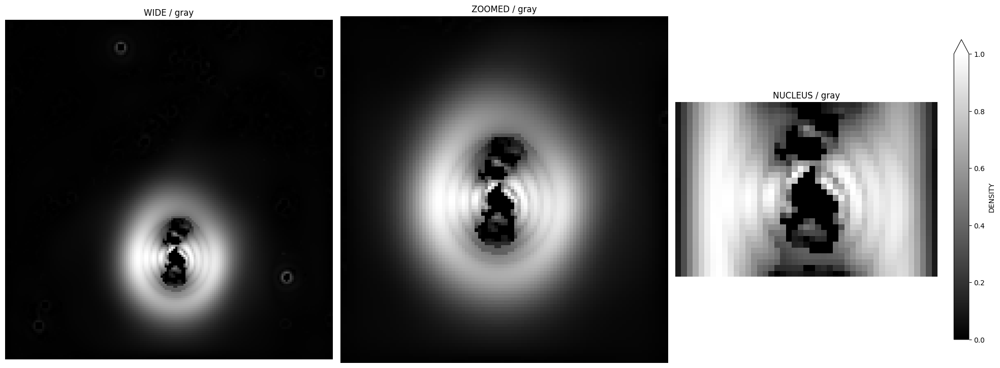

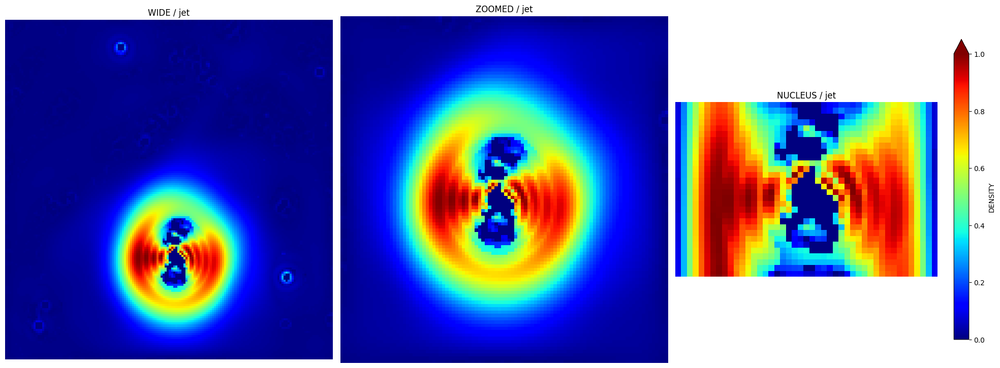

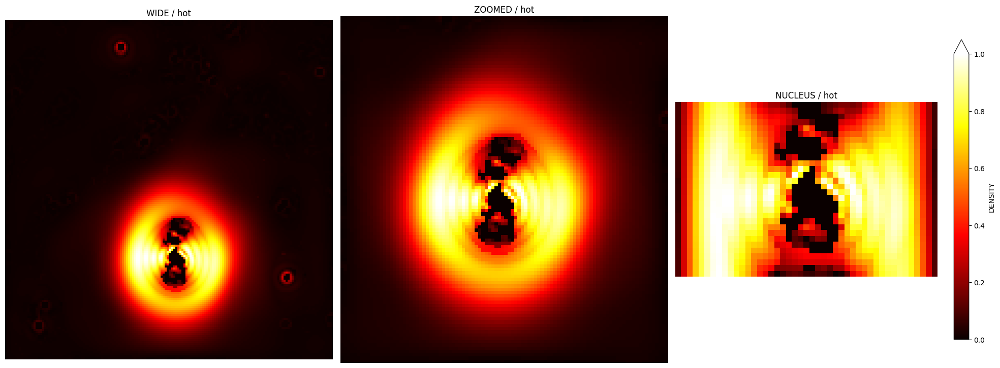

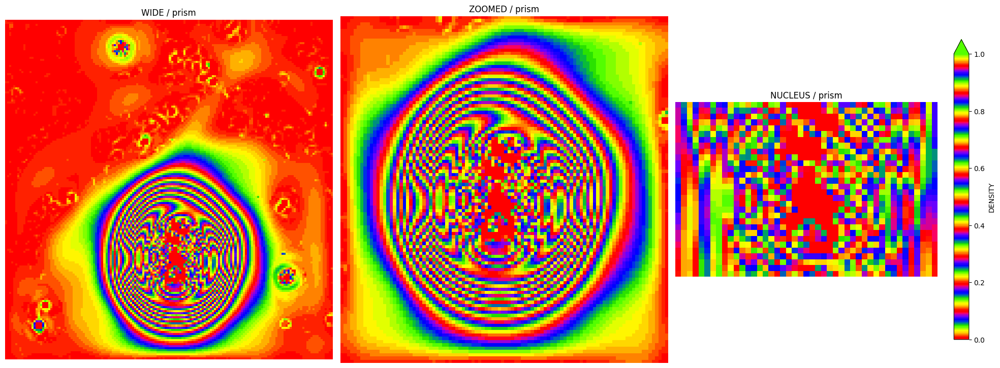

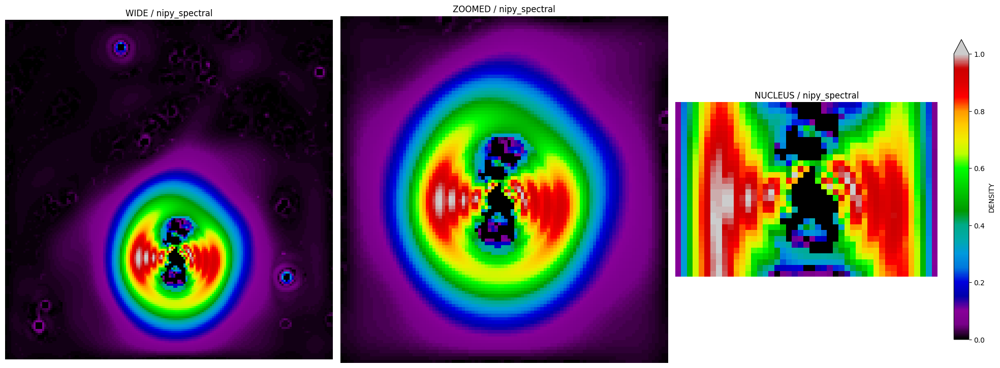

...

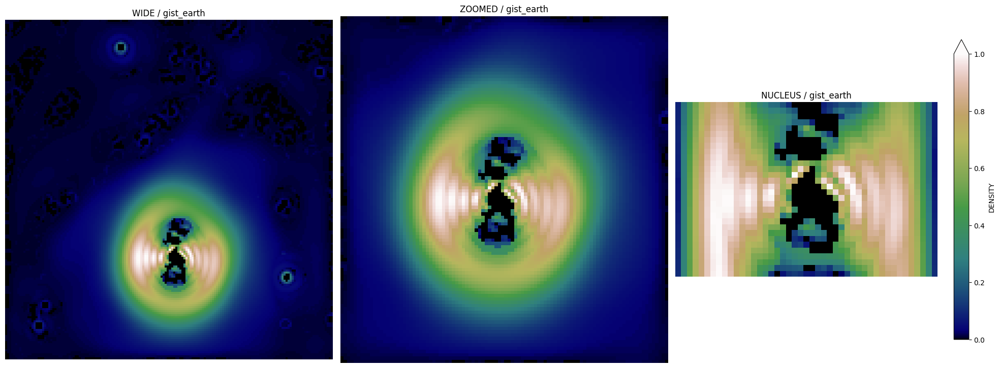

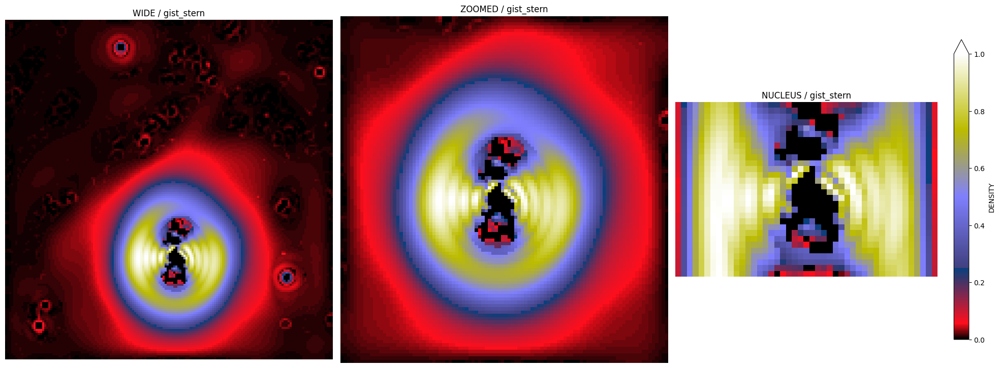

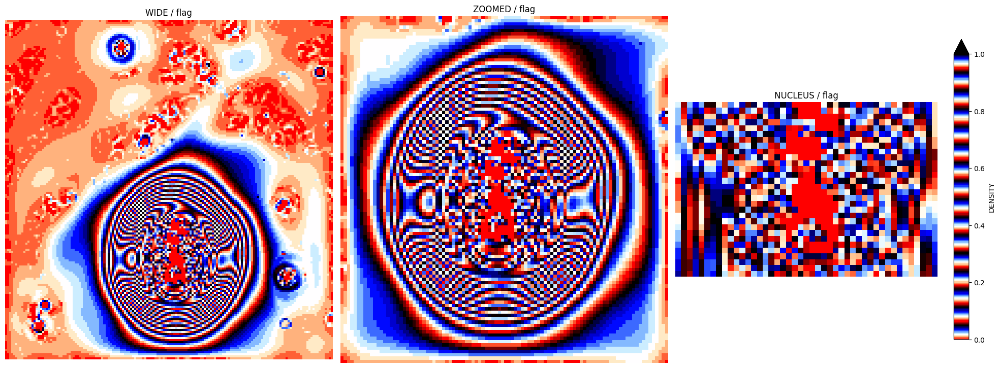

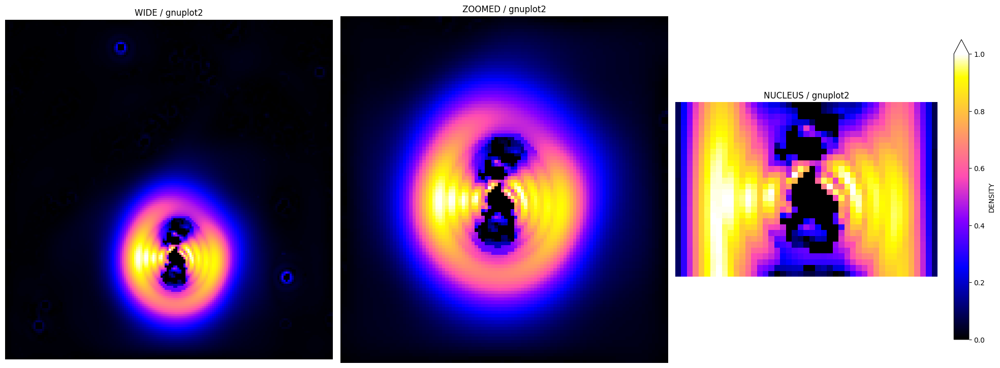

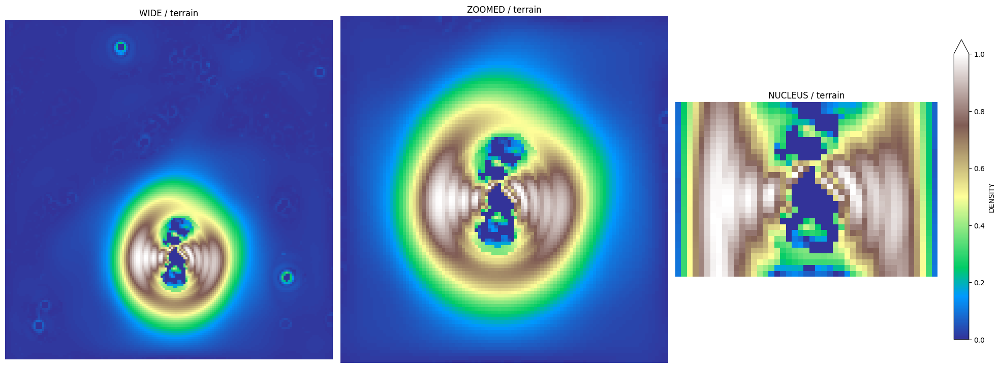

In [26]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,3,figsize=(20,20))
    
    axis[0].imshow(M_WIDE_SCALE_NI,cmap=x_spec)
    axis[0].set_title("WIDE" + " / "+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(M_ZOOMED_SCALE_NI,cmap=x_spec)
    axis[1].set_title("ZOOMED" + " / "+ x_spec)
    axis[1].axis("off")
    
    DENSITY_FUNC = axis[2].imshow(M_NUCLEUS_SCALE_NI,cmap=x_spec)
    axis[2].set_title("NUCLEUS" + " / "+ x_spec)
    axis[2].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",extend="max")
    plt.tight_layout()
    plt.show()

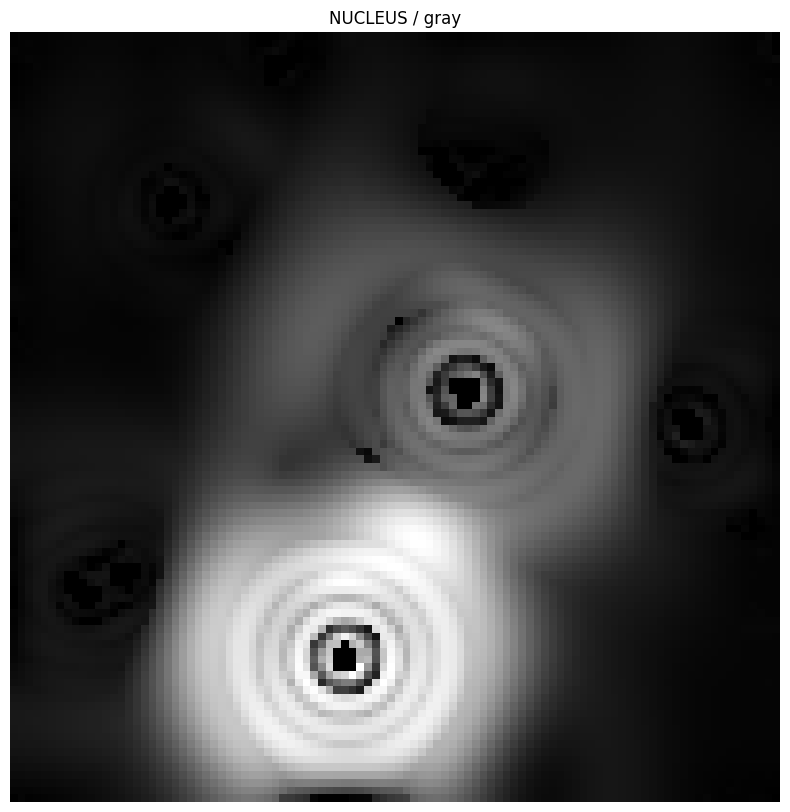

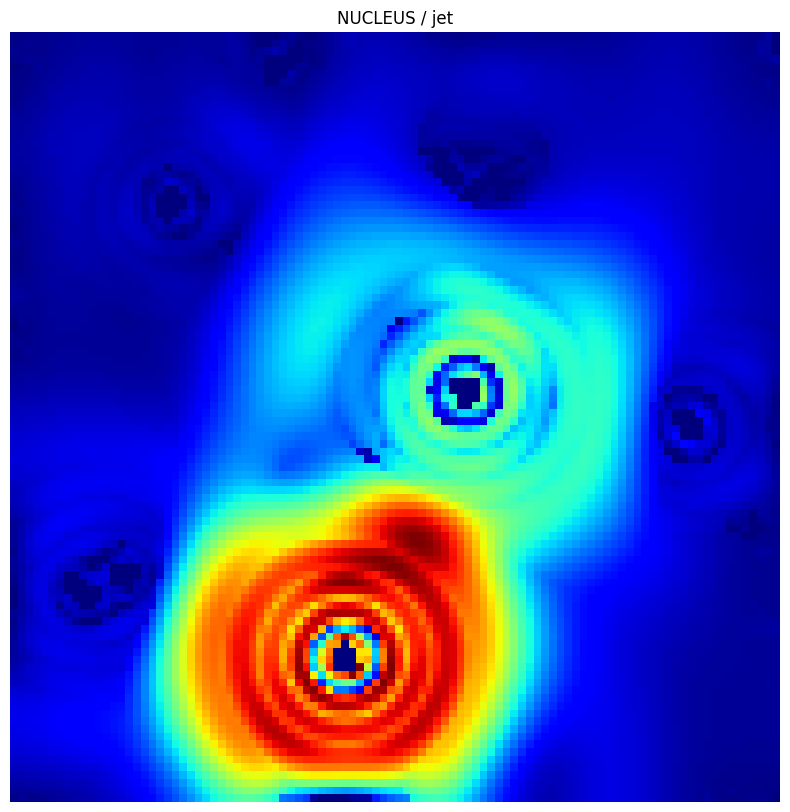

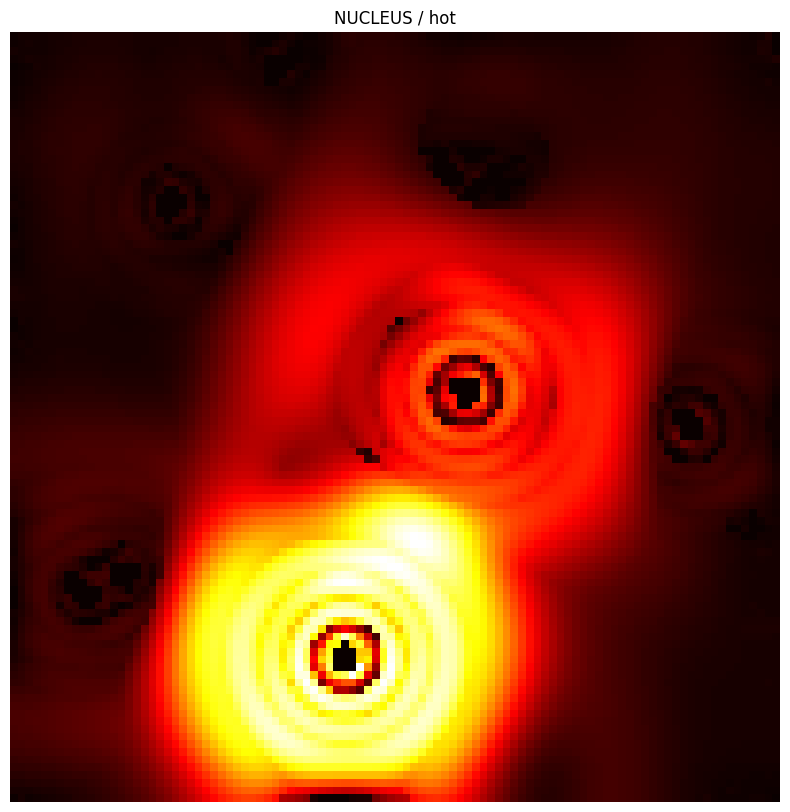

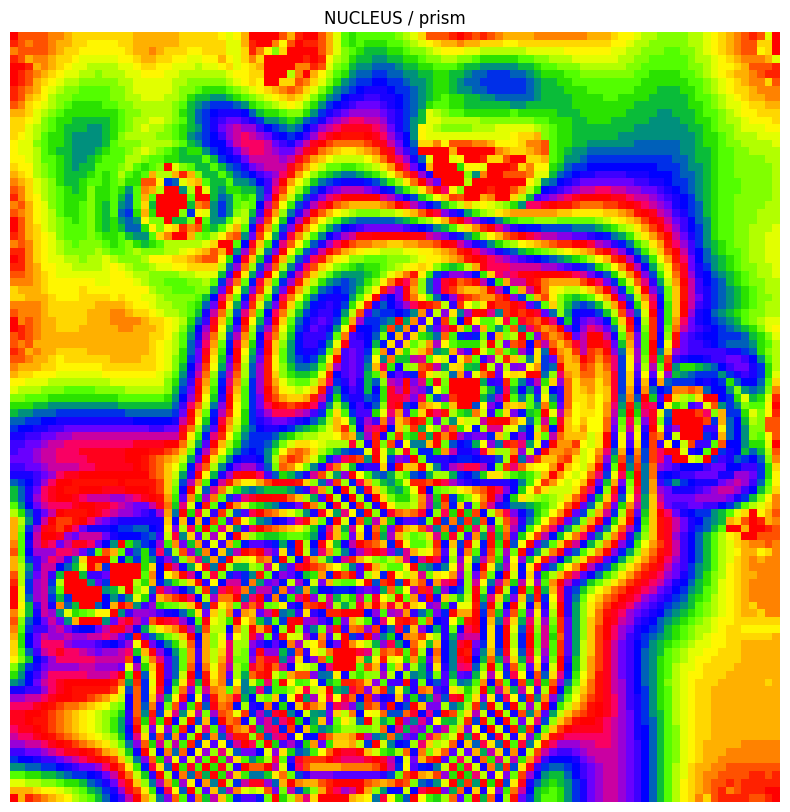

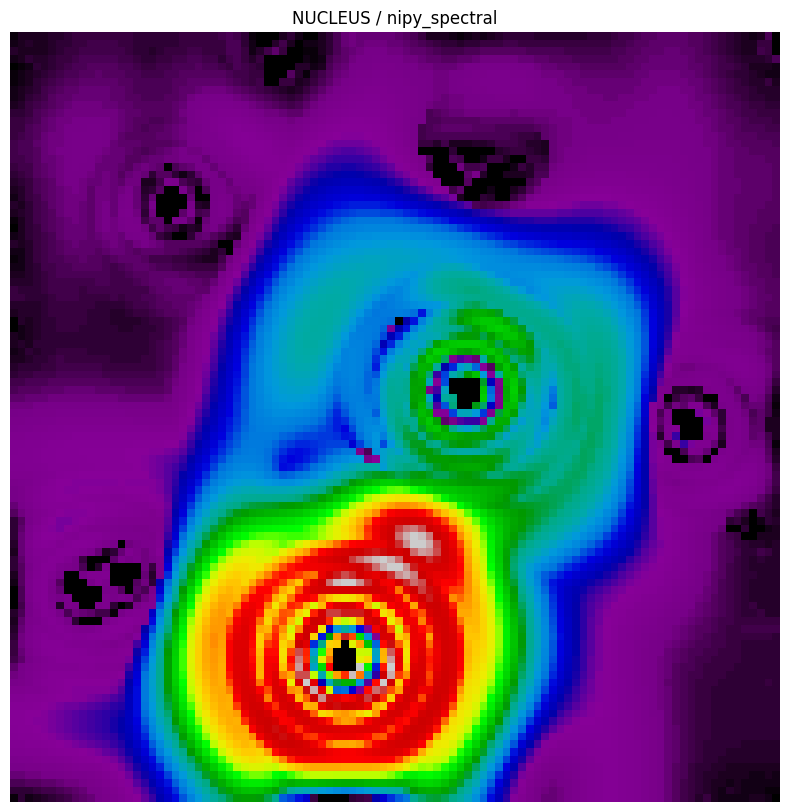

...

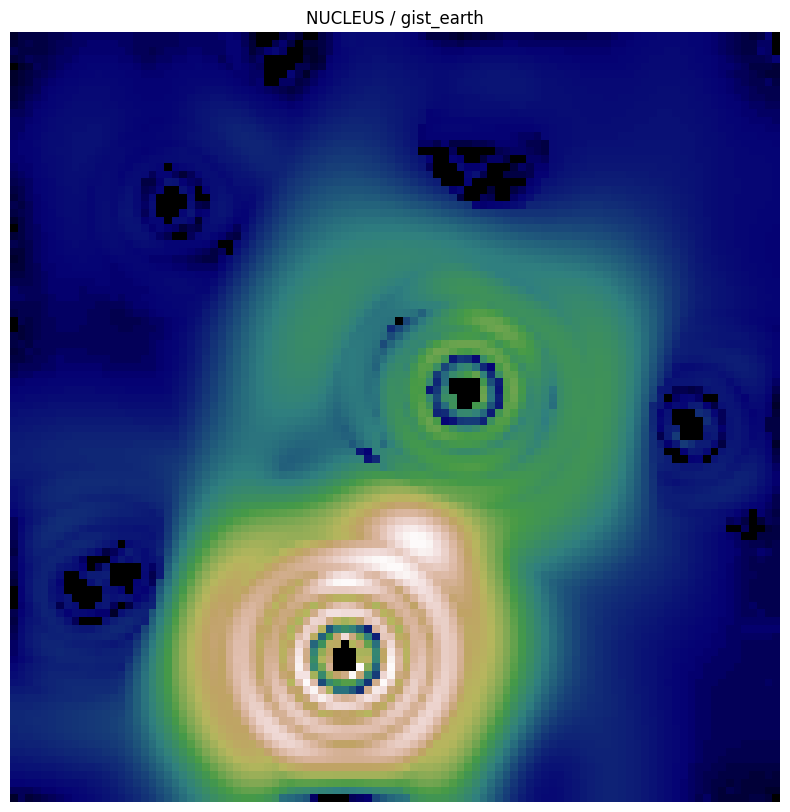

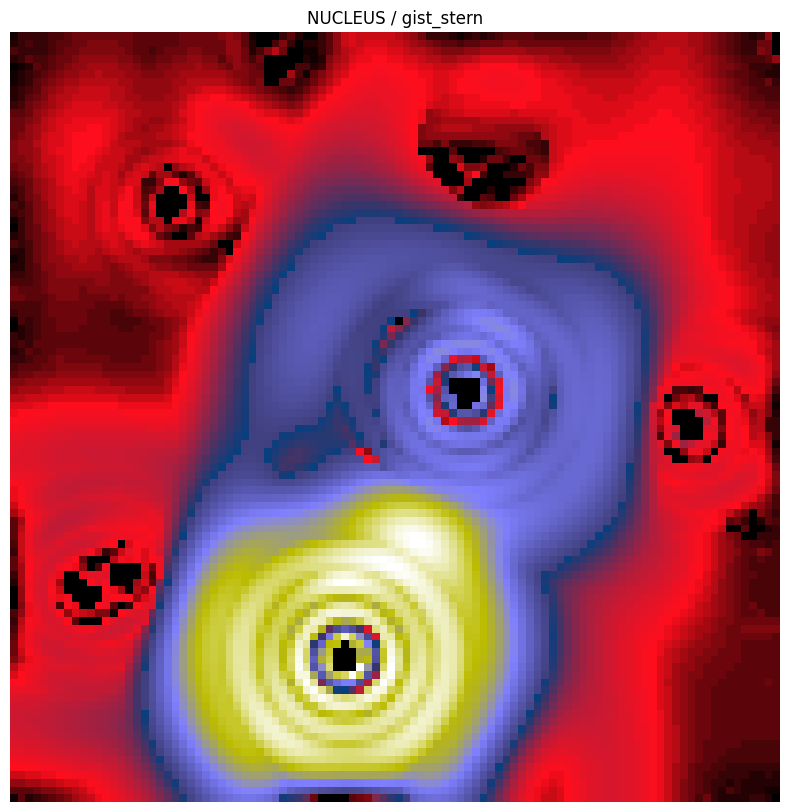

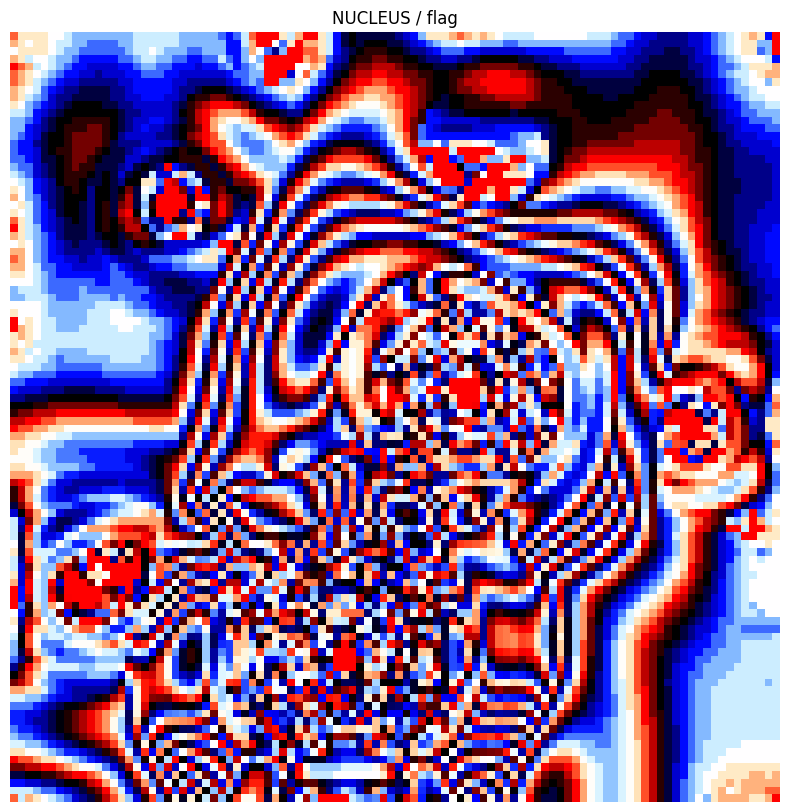

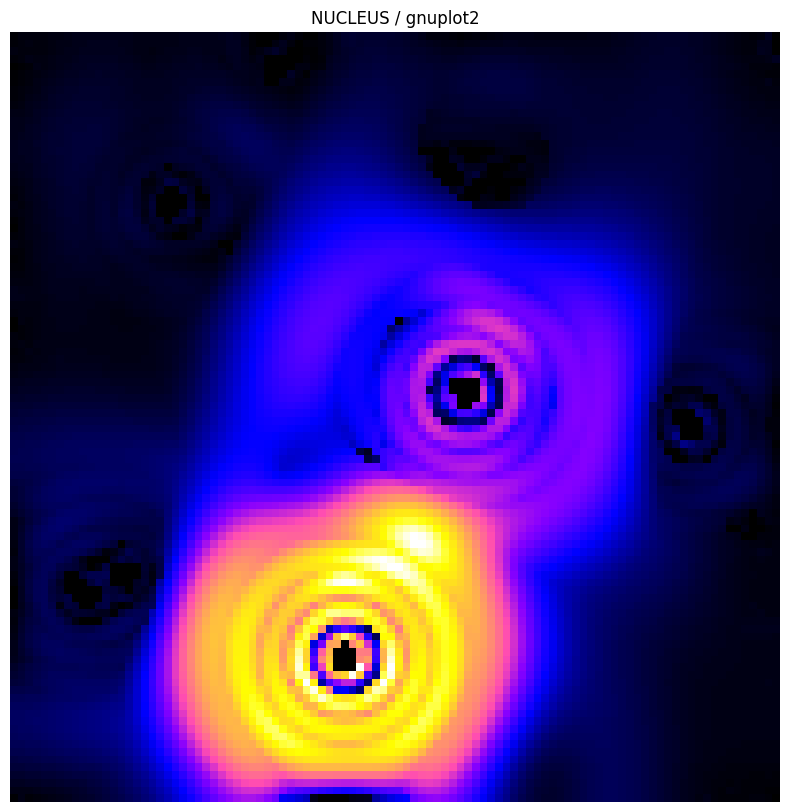

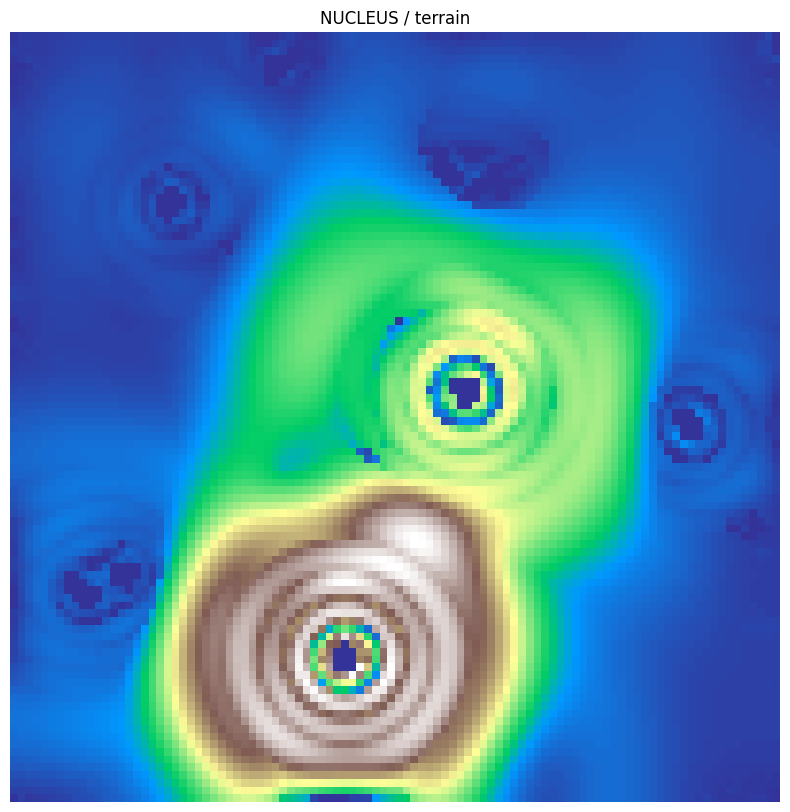

In [27]:
for x_spec in SPECTRAL_LIST:
    
    figure = plt.figure(figsize=(10,10))

    DENSITY_FUNC = plt.imshow(M_NUCLEUS_SCALE_NEWTON,cmap=x_spec)
    plt.title("NUCLEUS" + " / "+ x_spec)
    plt.axis("off")
    plt.show()

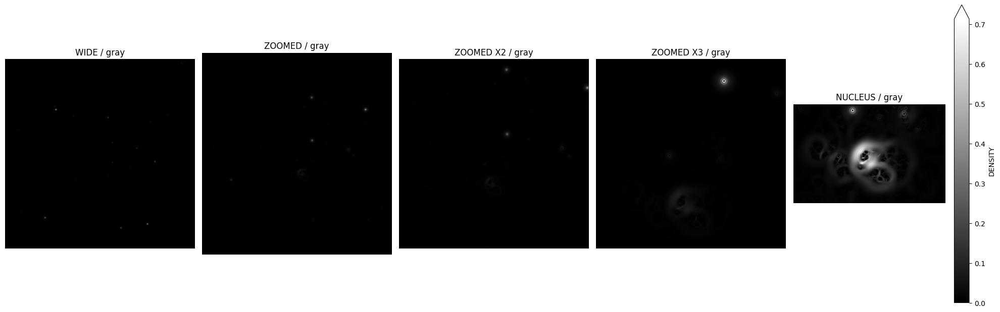

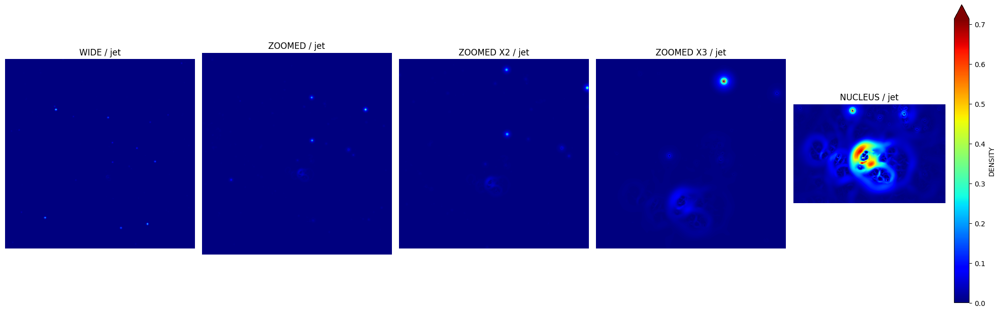

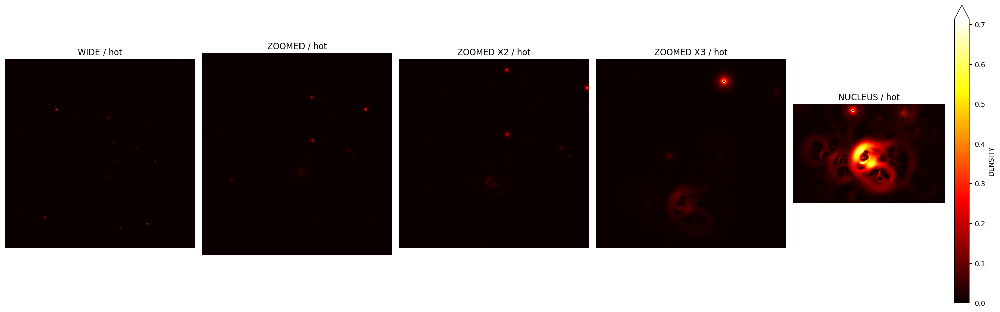

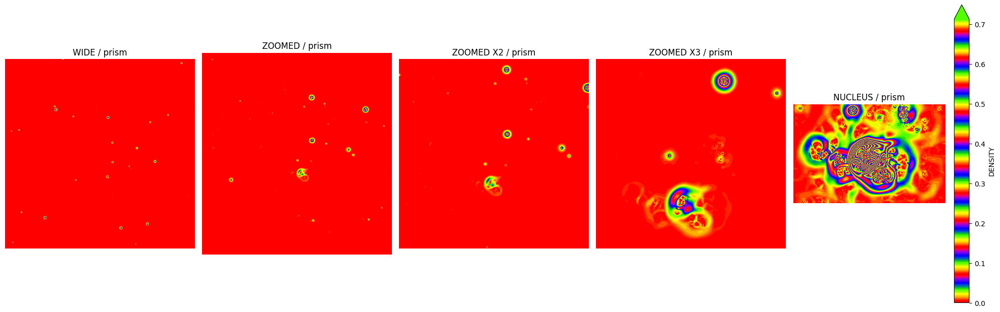

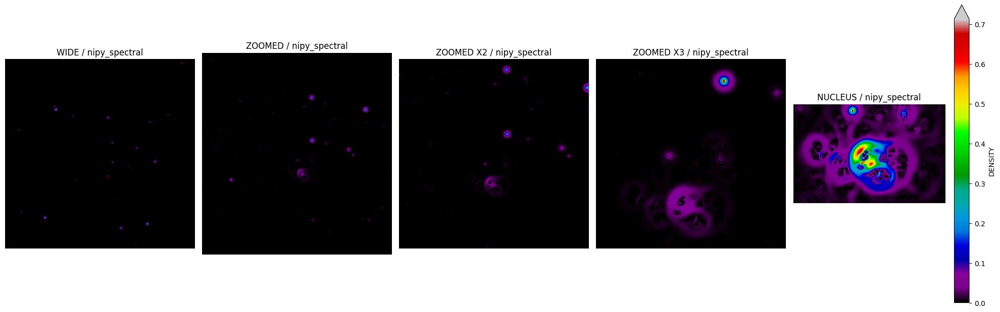

...

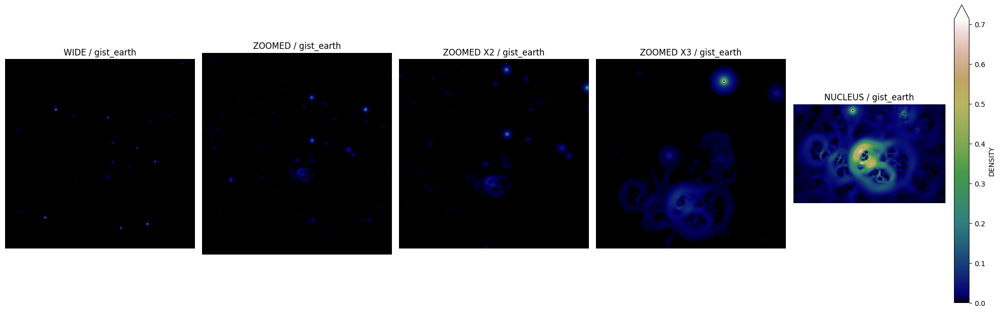

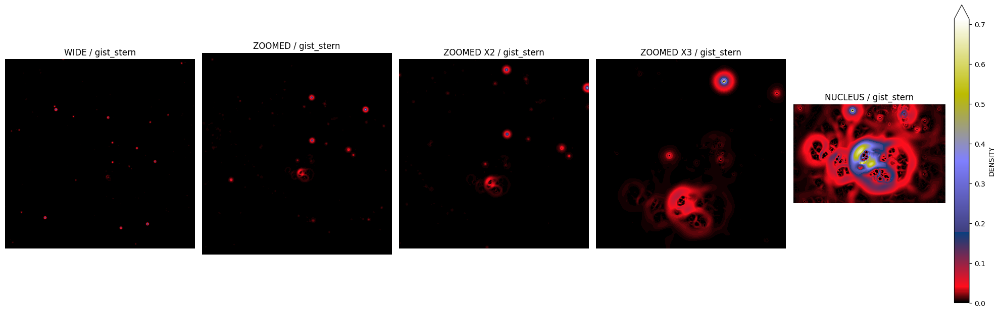

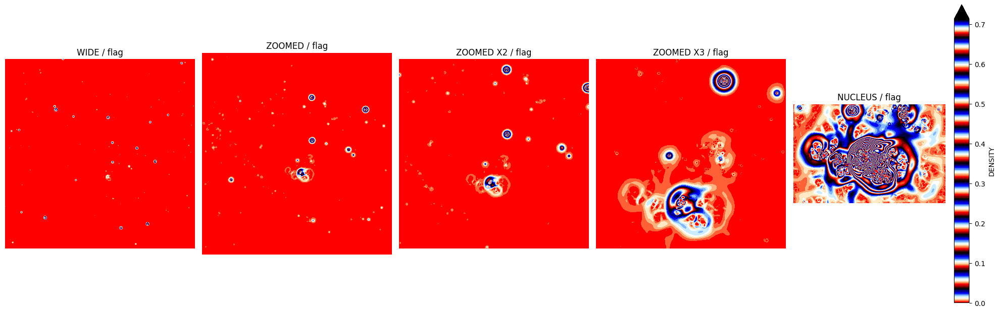

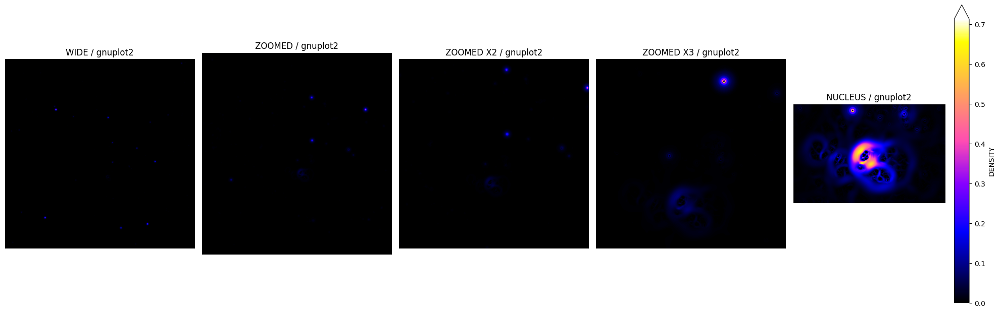

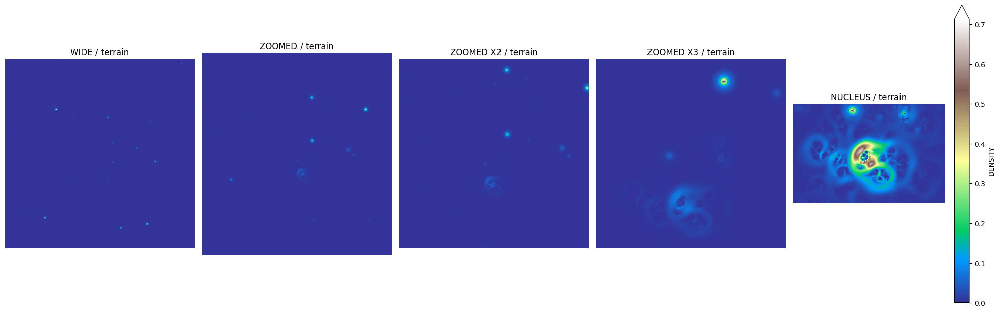

In [28]:
for x_spec in SPECTRAL_LIST:
    
    figure,axis = plt.subplots(1,5,figsize=(20,20))
    
    axis[0].imshow(SATO_WIDE_SCALE_HST,cmap=x_spec)
    axis[0].set_title("WIDE" + " / "+ x_spec)
    axis[0].axis("off")
    
    axis[1].imshow(SATO_ZOOMED_SCALE_HST,cmap=x_spec)
    axis[1].set_title("ZOOMED" + " / "+ x_spec)
    axis[1].axis("off")
    
    axis[2].imshow(SATO_ZOOMED_X2_SCALE_HST,cmap=x_spec)
    axis[2].set_title("ZOOMED X2" + " / "+ x_spec)
    axis[2].axis("off")
    
    axis[3].imshow(SATO_ZOOMED_X3_SCALE_HST,cmap=x_spec)
    axis[3].set_title("ZOOMED X3" + " / "+ x_spec)
    axis[3].axis("off")
    
    DENSITY_FUNC = axis[4].imshow(SATO_NUCLEUS_SCALE_HST,cmap=x_spec)
    axis[4].set_title("NUCLEUS" + " / "+ x_spec)
    axis[4].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label="DENSITY",  extend="max")
    plt.tight_layout()
    plt.show()

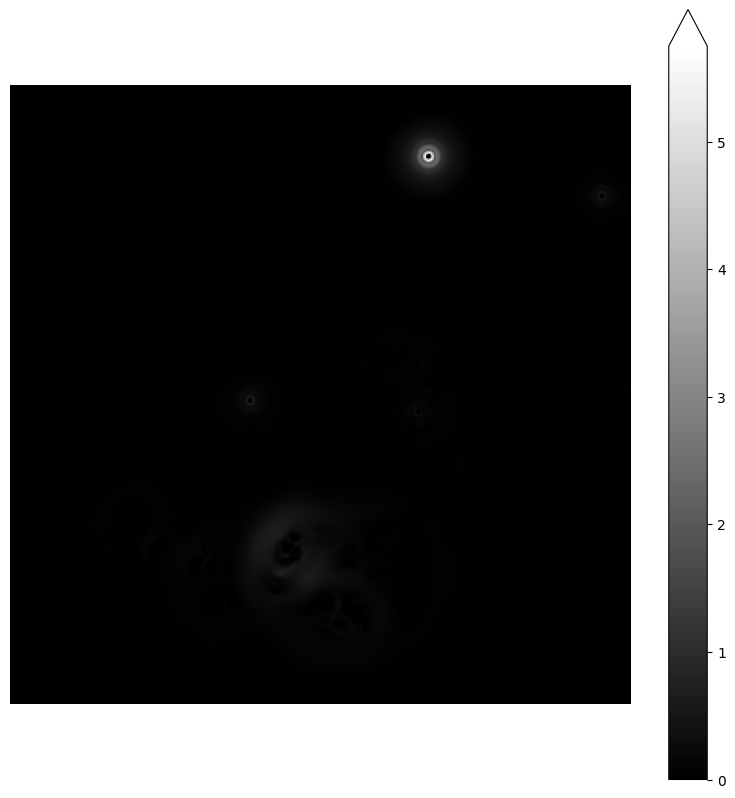

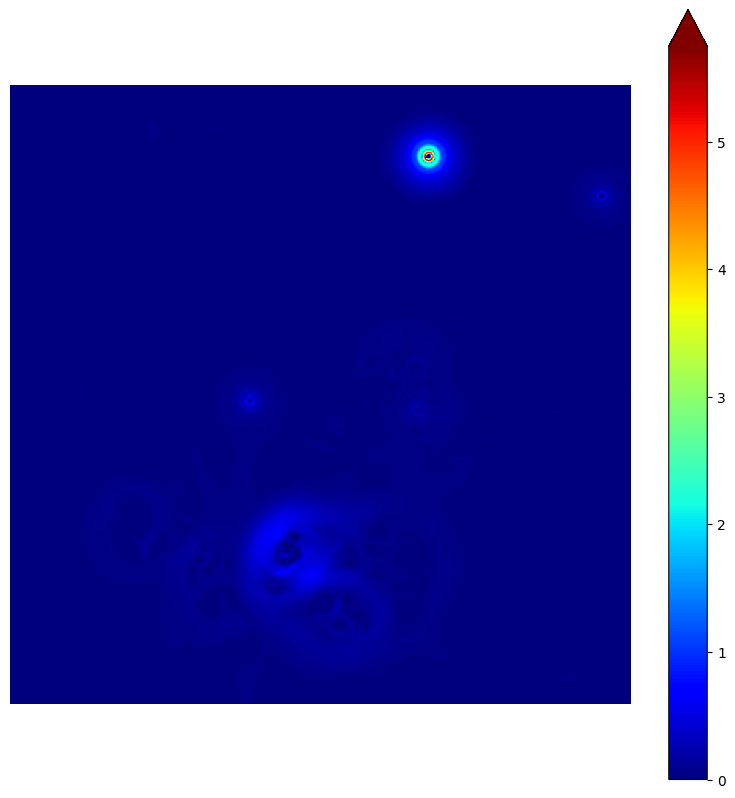

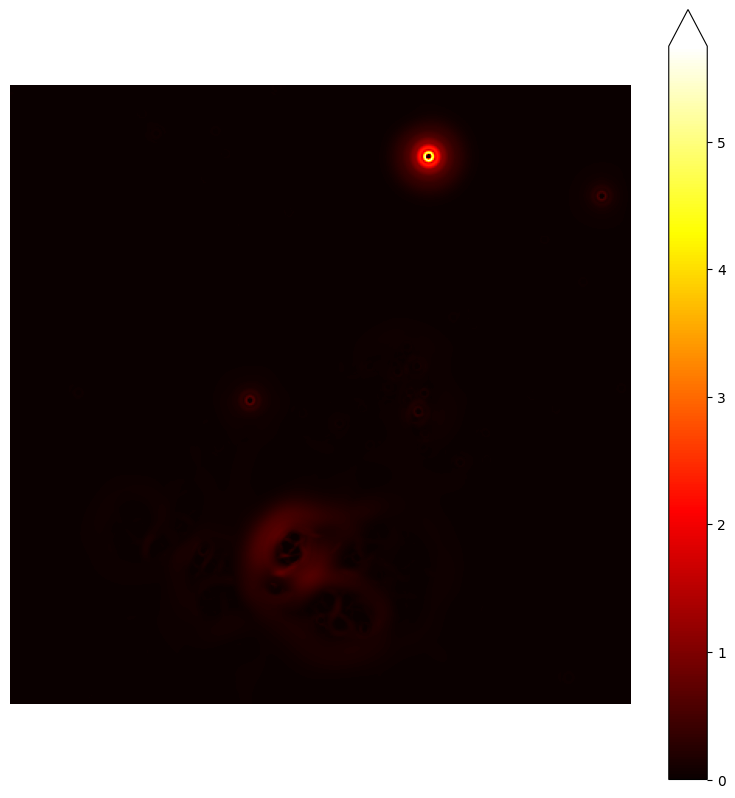

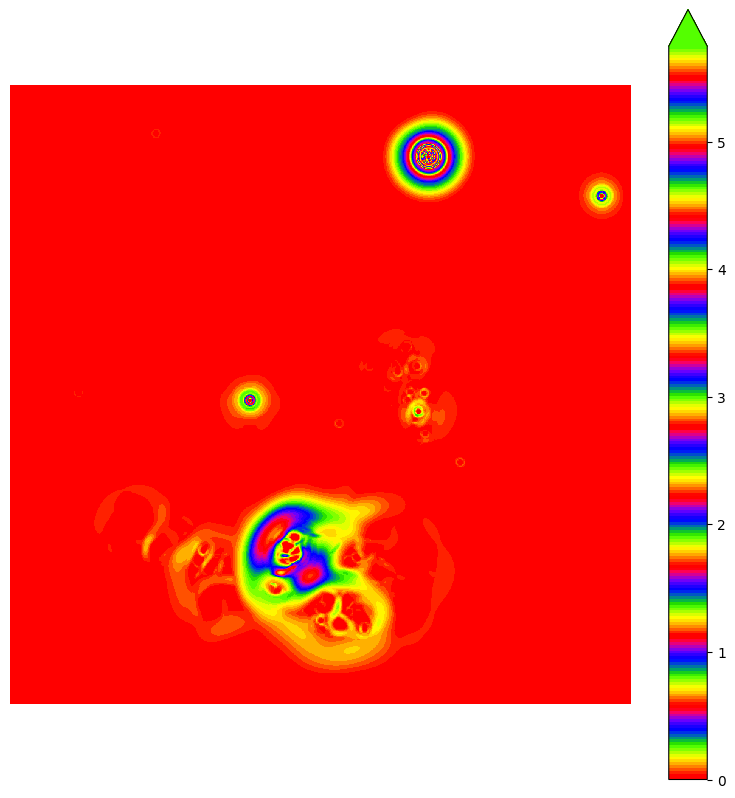

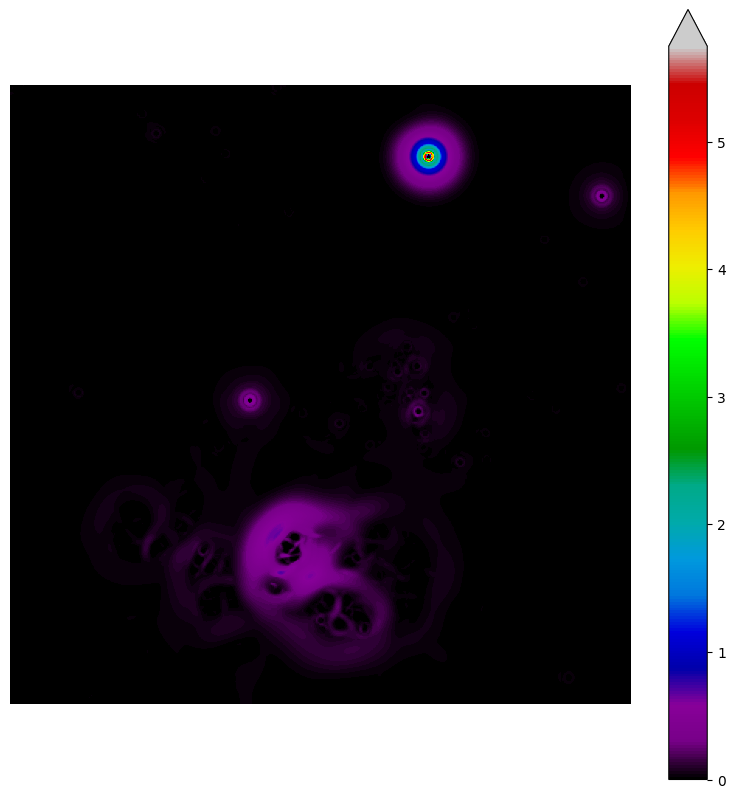

...

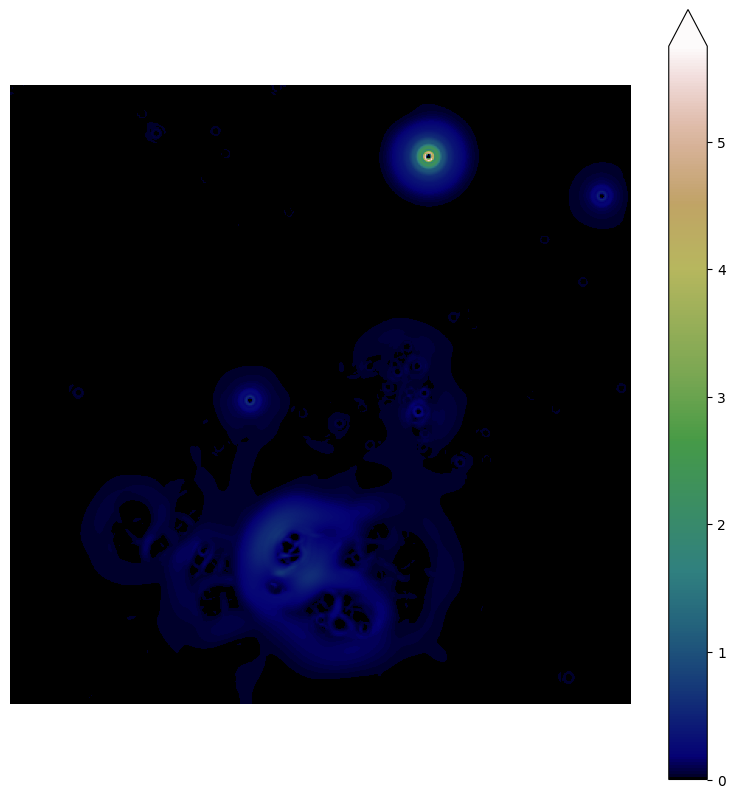

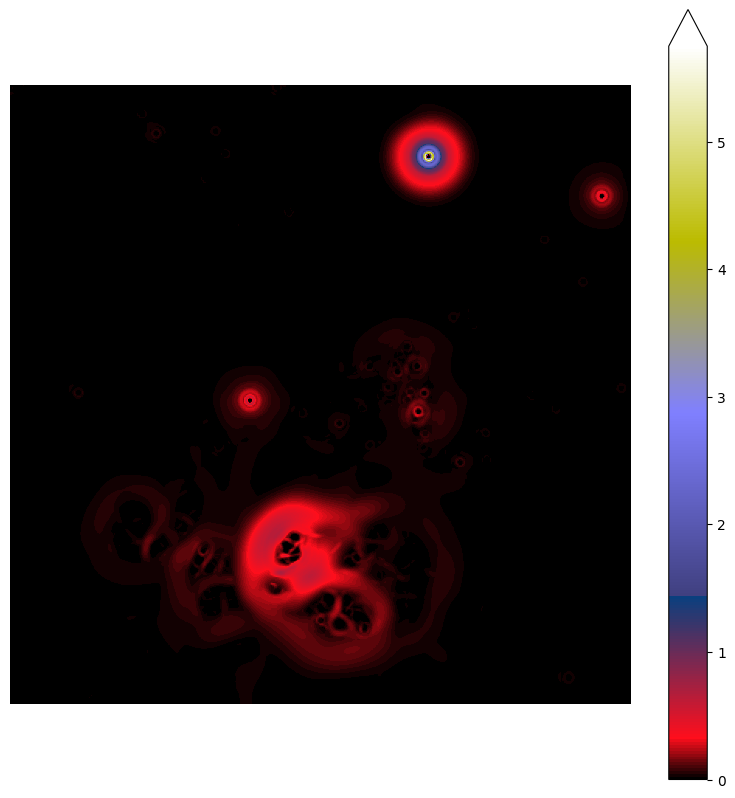

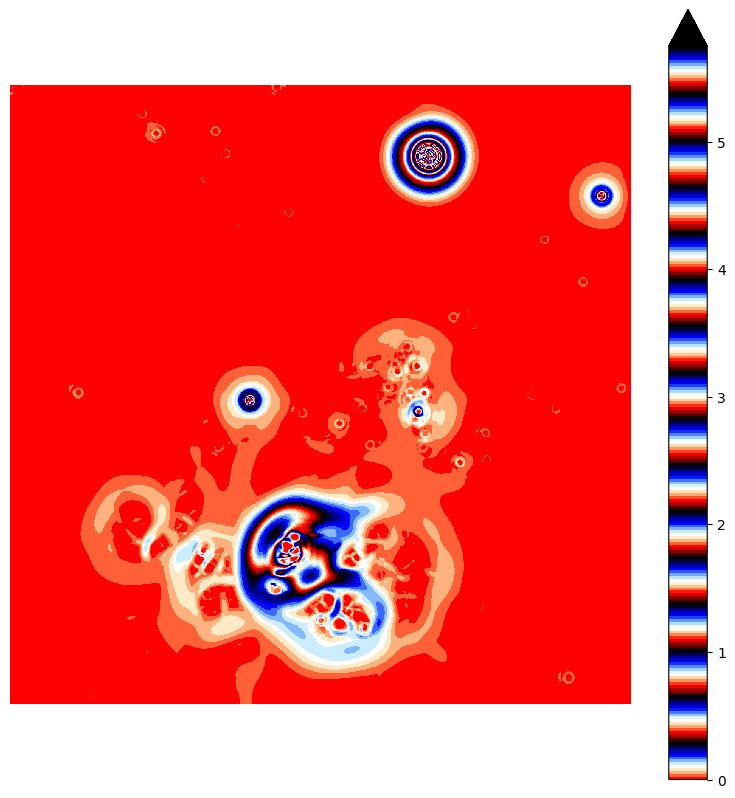

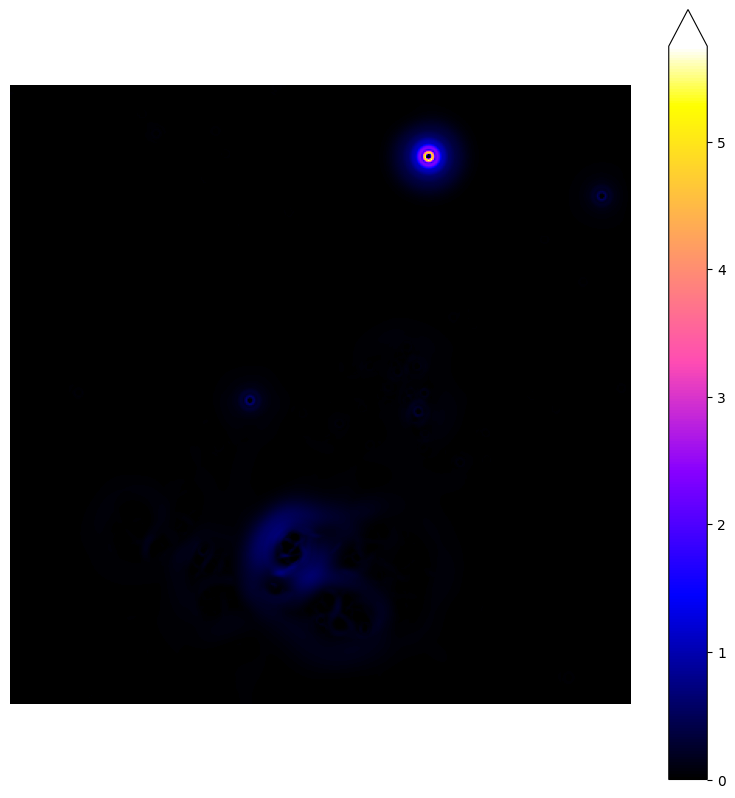

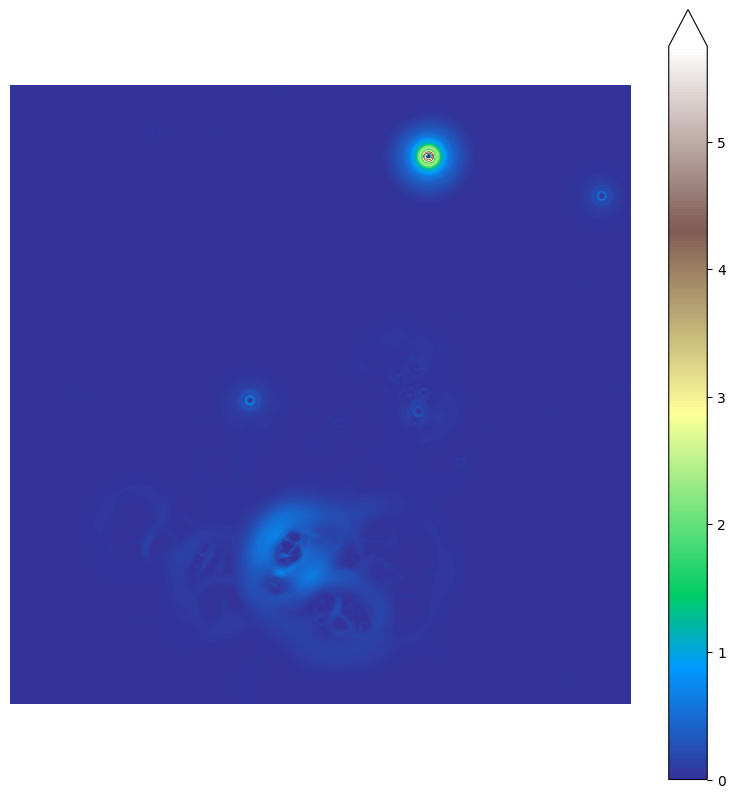

In [29]:
for x_spec in SPECTRAL_LIST:
    
    figure = plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(SATO_ZOOMED_X3_SCALE_HST,cmap=x_spec)
    plt.colorbar(  extend="max")
    plt.show()

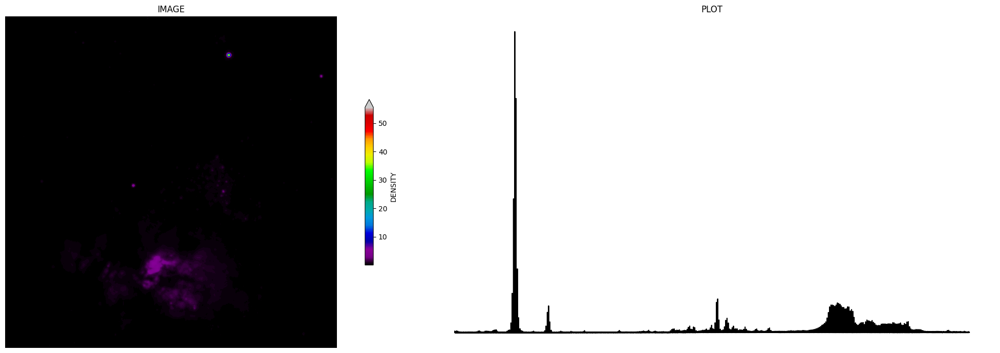

In [30]:

figure,axis = plt.subplots(1,2,figsize=(22,7))
    
DENSITY_FUNC = axis[0].imshow(ZOOMED_X3_SCALE_HST,cmap="nipy_spectral")
axis[0].set_title("IMAGE")
axis[0].axis("off")
    
axis[1].plot(ZOOMED_X3_SCALE_HST.flatten(),color="black")
axis[1].set_title("PLOT")
axis[1].axis("off")
    
figure.colorbar(DENSITY_FUNC,shrink=0.5,label="DENSITY",extend="max")
plt.tight_layout()
plt.show()

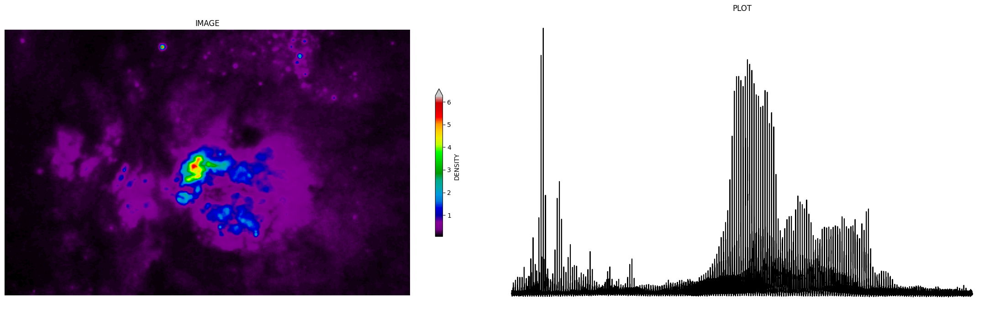

In [31]:
figure,axis = plt.subplots(1,2,figsize=(22,7))
    
DENSITY_FUNC = axis[0].imshow(NUCLEUS_SCALE_HST,cmap="nipy_spectral")
axis[0].set_title("IMAGE")
axis[0].axis("off")
    
axis[1].plot(NUCLEUS_SCALE_HST.flatten(),color="black")
axis[1].set_title("PLOT")
axis[1].axis("off")
    
figure.colorbar(DENSITY_FUNC,shrink=0.5,label="DENSITY",extend="max")
plt.tight_layout()
plt.show()

# SPECGRAM

In [32]:
data = ZOOMED_X3_SCALE_HST.flatten()
data

array([0.14134736, 0.22257417, 0.3537239 , ..., 0.11241787, 0.11014394,
       0.10772523], dtype=float32)

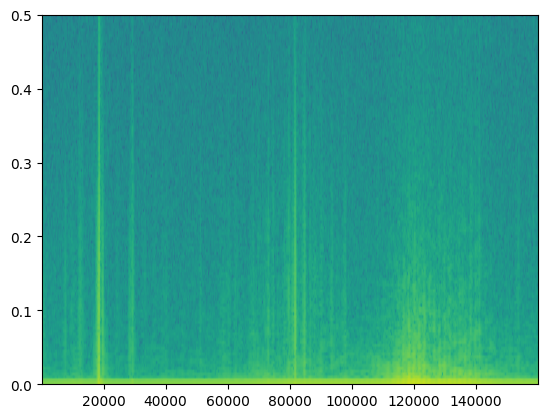

In [33]:
powerSpectrum_1, freqenciesFound_1, time_1, imageAxis_1=plt.specgram(data,Fs = 1)

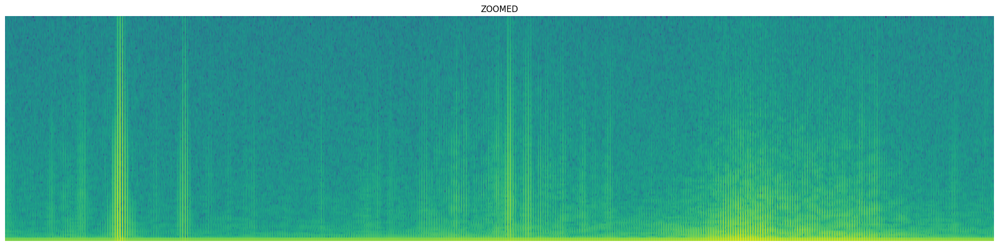

In [34]:
figure = plt.figure(figsize=(20,5))
powerSpectrum_1, freqenciesFound_1, time_1, imageAxis_1 = plt.specgram(ZOOMED_X3_SCALE_HST.flatten(),Fs = 1)
plt.axis("off")
plt.title("ZOOMED")
plt.tight_layout()
plt.show()

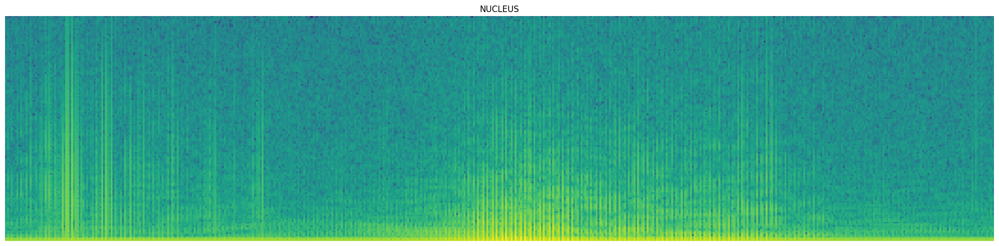

In [35]:
figure = plt.figure(figsize=(20,5))
powerSpectrum_1, freqenciesFound_1, time_1, imageAxis_1 = plt.specgram(NUCLEUS_SCALE_HST.flatten(),Fs =1)
plt.axis("off")
plt.title("NUCLEUS")
plt.tight_layout()
plt.show()

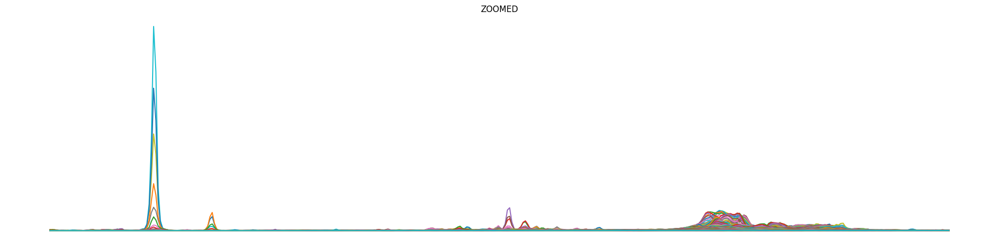

In [36]:
figure = plt.figure(figsize=(20,5))
plt.axis("off")
plt.title("ZOOMED")
plt.tight_layout()
plt.plot(ZOOMED_X3_SCALE_HST)
plt.show()

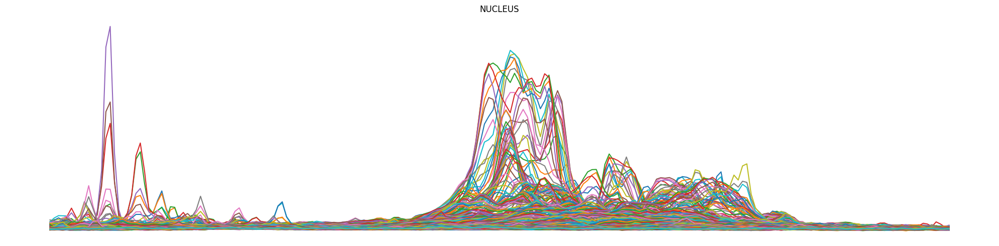

In [37]:
figure = plt.figure(figsize=(20,5))
plt.axis("off")
plt.title("NUCLEUS")
plt.tight_layout()
plt.plot(NUCLEUS_SCALE_HST)
plt.show()